## Model organ specific celltype signatures

In [1]:
import os,sys
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse
import anndata

In [2]:
import pyscenic.aucell

In [3]:
## import utils
cwd = '../utils/'
sys.path.append(cwd)

import genes
import panfetal_utils

# import ti_utils

In [4]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [5]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

Activate the anndata2ri conversion between SingleCellExperiment and AnnData

In [6]:
anndata2ri.activate()

In [7]:
%load_ext rpy2.ipython

In [8]:
%%R
library(tidyverse)

## Save lymphoid matrix 4 LMM

Run by Natsuhiko

In [456]:
# adata_lymph_all = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.LYMPHOID.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
adata_lymph = panfetal_utils._load_split_and_annotation("LYMPHOID")

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3337: DtypeWarning: Columns (9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [318]:
adata_lymph_bc = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.LYMPHOID.batchCorrected.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [5]:
# adata_lymph.var.to_csv("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.LYMPHOID.lmm_logcounts.var.csv")

In [320]:
adata_lymph = adata_lymph[adata_lymph_bc.obs_names]
adata_lymph.obsm = adata_lymph_bc.obsm.copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [67]:
## Add annotations

anno_b = pd.read_csv("../manual_annotation/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.B_CLEAN_CLEAN.batchCorrected_annotation.csv")
anno_b.index = anno_b['index']

anno_nkt = pd.read_csv("../manual_annotation/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.NKT_CLEAN.batchCorrected_annotation.csv")
anno_nkt.index = anno_nkt['index']

In [63]:
anno_lymph = pd.concat([anno_nkt, anno_b]).drop_duplicates()

In [64]:
adata_lymph = adata_lymph[anno_lymph.index]

In [8]:
adata_lymph.obs = pd.concat([adata_lymph.obs, anno_lymph], 1)

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
adata_lymph.obs.loc[adata_lymph.obs.organ=="TH(pharyn)","organ"] = "TH"

In [10]:
adata_lymph.obs[["Sample", "donor", "organ", "anno_lvl_2", "age", "method"]].to_csv("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.LYMPHOID.lmm_metadata.csv")

In [164]:
import scipy.io
scipy.io.mmwrite("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.LYMPHOID.lmm_logcounts.mtx", adata_lymph.X)

In [ ]:
anno_b.iloc[np.where(anno_b.index.isin(anno_nkt.index))].value_counts('anno_lvl_2')

### Implement pseudobulking

In [423]:
def anndata2pseudobulk(adata, group_by, agg="s", min_ncells = 10):
    '''
    Params:
    ------
    adata: the anndata object
    group_by: list of obs columns to use for aggregation
    agg: "s" for sum (if adata.X are counts), "m" for mean (if adata.X are log-counts)
    min_ncells: minimum number of cells to keep pseudobulk sample (default=10)
    '''
    from scipy.sparse import csr_matrix
    if agg=="s" and "log1p" in adata.uns_keys():
        print("adata.X is in log-transformed, pseudobulking should be done on counts")
        return()
    ## Make obs for pseudobulk
    pseudobulk_obs = adata.obs[group_by].drop_duplicates()
    pseudobulk_obs = pseudobulk_obs[group_by].astype("str")
    pseudobulk_obs.index = pseudobulk_obs[group_by].agg("-".join, axis=1)
    ## Add column to obs assigning cells to pseudobulk samples
    adata.obs[group_by] = adata.obs[group_by].astype("str")
    adata.obs["pseudobulk_sample"] = adata.obs[group_by].agg("-".join, axis=1)
    ## Sum counts from same sample
    sample_dummies = pd.get_dummies(adata.obs["pseudobulk_sample"])[pseudobulk_obs.index].values
    sample_dummies = scipy.sparse.csr_matrix(sample_dummies)
    pseudobulk_X = adata.X.T.dot(sample_dummies)
    ## Check that pseudobulk profiles are the sum of all profiles in a sample
    a = np.array(adata[sample_dummies[:,0]!=0].X.sum(0)).flatten()
    b = pseudobulk_X[:,0].toarray().flatten()
    if not np.all(a == b):
        print("Error! Aggregation doesn't coincide with sum across the same sample")
        return()
    if agg=="m":
        pseudobulk_X = csr_matrix(pseudobulk_X / sample_dummies.toarray().sum(0))
#         ## Check that pseudobulk profiles are the mean of all profiles in a sample
#         a = np.array(adata[sample_dummies[:,0]!=0].X.mean(0)).flatten()
#         b = pseudobulk_X[:,0].toarray().flatten()
#         if not np.all(a == b):
#             print("Error! Aggregation doesn't coincide with mean across the same sample")
#             return()
    ## Make new anndata object
    pseudobulk_adata = anndata.AnnData(pseudobulk_X.T, obs=pseudobulk_obs, var=adata.var)
    ## Add number of cells to obs 
    n_cells = adata.obs.groupby('pseudobulk_sample').count().iloc[:,0]
    n_cells.name = "n_cells"
    pseudobulk_adata.obs = pd.concat([pseudobulk_adata.obs, n_cells], axis=1)
    ## Filter obs by number of cells threshold
    pseudobulk_adata = pseudobulk_adata[pseudobulk_adata.obs['n_cells'] >= min_ncells]
    return(pseudobulk_adata)

In [424]:
pbulk_adata = anndata2pseudobulk(adata, ["Sample", "donor", "organ", "anno_lvl_2", "age", "method"], agg="m")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [427]:
pbulk_adata

View of AnnData object with n_obs × n_vars = 1290 × 33694
    obs: 'Sample', 'donor', 'organ', 'anno_lvl_2', 'age', 'method', 'n_cells'
    var: 'GeneName', 'GeneID'

In [421]:
pbulk_adata

AnnData object with n_obs × n_vars = 2510 × 33694
    obs: 'Sample', 'donor', 'organ', 'anno_lvl_2', 'age', 'method', 'n_cells'
    var: 'GeneName', 'GeneID'

### Read reults from Natsuhiko 

In [10]:
de_res = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/significant_genes/LMM_Natsuhiko_results/de_lymphoid_ltsr0.9.csv")
de_res.columns = [x.split(" ")[0] for x in de_res.columns]
# de_res.celltype = [" ".join(x.split("_")) + " CELL" for x in de_res.celltype]

In [11]:
def get_de_genes(de_res, ct, organ, minFC=0, select_genes=None):
    keep_gene = (de_res.celltype==ct) & (de_res.organ==organ)
    if minFC > 0:
        keep_gene = keep_gene & (abs(de_res.logFoldChange) > minFC)
    if select_genes:
        if select_genes=="up":
            keep_gene = keep_gene & (de_res.logFoldChange > 0)
        if select_genes=="down":
            keep_gene = keep_gene & (de_res.logFoldChange < 0)
    de_genes = de_res[keep_gene].gene
    return(de_genes)

In [12]:
adata_lymph = panfetal_utils._load_split_and_annotation("LYMPHOID", full_mat=False)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3337: DtypeWarning: Columns (9,13,14,15) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [13]:
adata_lymph_all = panfetal_utils._load_split_and_annotation("LYMPHOID", full_mat=True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [14]:
adata_lymph_all = adata_lymph_all[adata_lymph.obs_names]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [15]:
adata_lymph_all.obsm = adata_lymph.obsm.copy()
adata_lymph_all.obsp = adata_lymph.obsp.copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [16]:
## Load used annotation
anno = pd.read_csv('/nfs/team205/nk5/Team205/ed6/metadata.csv.gz', index_col=0)
anno = anno[anno.index.isin(adata_lymph_all.obs_names)] ## remove cells not in adata
anno = anno[~anno.index.duplicated()]

In [ ]:
adata = adata_lymph_all[anno.index]
adata.var_names_make_unique()
adata.obs["celltype"] = anno["anno_lvl_2"]

### Save fraction of cells expressing genes in each organ-celltype

In [314]:
## Subset anndata to DE genes
genes = de_res.gene.unique()
genes = genes[pd.Series(genes).isin(adata.var_names)]
adata_de_genes = adata[:,genes]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [315]:
## Make obs for pseudobulk
group_by = ["organ", "celltype"]
pseudobulk_obs = adata.obs[group_by].drop_duplicates()
pseudobulk_obs.index = pseudobulk_obs[group_by].agg("-".join, axis=1)
## Add column to obs assigning cells to pseudobulk samples
adata_de_genes.obs["pseudobulk_sample"] = adata_de_genes.obs[group_by].agg("-".join, axis=1)

Trying to set attribute `.obs` of view, copying.


In [316]:
## Make gex matrix binary (gene on /off)
adata_de_genes.layers["X_binary"] = adata_de_genes.X.copy()
adata_de_genes.layers["X_binary"][adata_de_genes.layers["X_binary"] != 0] = 1

In [318]:
## Sum counts
sample_dummies = pd.get_dummies(adata_de_genes.obs["pseudobulk_sample"])[pseudobulk_obs.index].values
sample_dummies = scipy.sparse.csr_matrix(sample_dummies)

ncells_X = adata_de_genes.layers["X_binary"].T.dot(sample_dummies)

In [319]:
## Tot number of cells per organ-celltype
tot_cells = adata_de_genes.obs.groupby('pseudobulk_sample').count().iloc[:,0]
tot_cells.name = "tot_cells"
tot_cells = tot_cells[pseudobulk_obs.index]

fraccells_X = ncells_X.toarray().T / tot_cells.values[:,None]
frac_X_df = pd.DataFrame(fraccells_X, columns=genes, index=pseudobulk_obs.index)
frac_X_df["organ"] = pseudobulk_obs.organ
frac_X_df["celltype"] = pseudobulk_obs.celltype
frac_X_df["tot_cells"] = tot_cells

In [321]:
## Associate gene to celltype where it's DE
DEgene2ct_df = de_res[["gene","celltype"]]
DEgene2ct_df["count"] = 1
DEgene2ct_df = DEgene2ct_df.pivot(index="gene", columns='celltype', values="count").fillna("0")
DEgene2ct_df

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


celltype,B1,CD4+T,CD8+T,CD8aa,CYCLING_MATURE_B,DN(P)/DN(early),DN(Q),DP(P),DP(Q),EARLY_PRO_B,...,MPP,NK,NKT,PLASMA_B,PRO_B,PRO_TO_PRE_B,Progenitor,SMALL_PRE_B,Treg,abT(entry)
gene,,,,,,,,,,,,,,,,,,,,,
A1BG,0,1.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AADAT,0,0,0,0,0,0,0,0,0,0,...,1.0,0,0,0,0,0,0,0,0,0
AAED1,0,0,0,0,0,0,0,0,0,0,...,1.0,0,0,0,0,0,1.0,0,0,0
AAK1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1.0,0,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZSCAN16-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1.0,0,0,0
ZSCAN18,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ZSCAN30,0,0,0,0,0,0,1.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [375]:
ct = "NKT"
de_org = "SP"

gs_down = get_de_genes(de_res, ct, de_org, minFC=0.3, select_genes="down")
gs_up = get_de_genes(de_res, ct, de_org, minFC=0.3, select_genes="up")

c_fracs = frac_X_df[(frac_X_df.celltype==ct)] 
c_fracs = c_fracs[c_fracs.tot_cells > 50]
c_fracs = c_fracs[pd.concat([gs_up, gs_down])]

c_fracs

,AIF1,XCL1,XCL2,SERPINH1,CD160,S100A6,ARL6IP5,CD44,PDCD4,KLRB1,DDIT4,CD83,FXYD5,TSC22D3,LTB,JUN,S100A4
LI-NKT,0.547980,0.422980,0.305556,0.094697,0.171717,0.642677,0.508838,0.806818,0.558081,0.707071,0.699495,0.159091,0.676768,0.707071,0.731061,0.611111,0.813131
SP-NKT,0.789179,0.746891,0.537313,0.389925,0.213619,0.389614,0.499067,0.849502,0.434391,0.671642,0.611629,0.217351,0.556281,0.667600,0.803172,0.631530,0.639925
BM-NKT,0.721925,0.727273,0.475936,0.058824,0.155080,0.465241,0.657754,0.919786,0.620321,0.754011,0.604278,0.058824,0.593583,0.711230,0.796791,0.390374,0.705882
TH-NKT,0.809430,0.717092,0.561886,0.259332,0.062868,0.416503,0.683694,0.864440,0.626719,0.656189,0.781925,0.137525,0.632613,0.528487,0.834971,0.654224,0.730845
SK-NKT,0.633690,0.632353,0.419786,0.131016,0.058824,0.533422,0.533422,0.872995,0.486631,0.735294,0.629679,0.231283,0.636364,0.783422,0.843583,0.536096,0.727273
KI-NKT,0.843137,0.637255,0.352941,0.235294,0.147059,0.509804,0.598039,0.921569,0.568627,0.705882,0.666667,0.176471,0.627451,0.666667,0.882353,0.764706,0.666667
GU-NKT,0.492308,0.425641,0.225641,0.102564,0.117949,0.558974,0.594872,0.743590,0.692308,0.866667,0.697436,0.051282,0.569231,0.666667,0.923077,0.579487,0.661538
MLN-NKT,0.688073,0.596330,0.458716,0.091743,0.073394,0.559633,0.669725,0.917431,0.779817,0.596330,0.614679,0.431193,0.788991,0.917431,0.954128,0.990826,0.651376


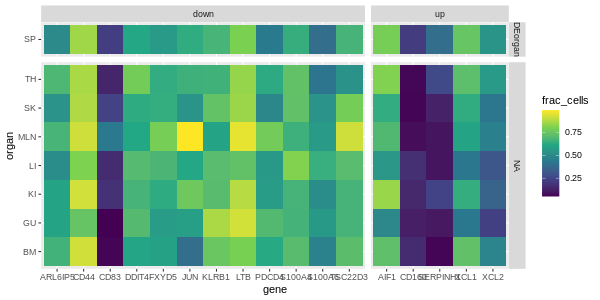

In [376]:
%%R -i c_fracs -i gs_up -i gs_down -i de_org -w 600 -h 300

c_fracs %>%
    rownames_to_column("pair") %>%
    pivot_longer(cols=-pair, names_to="gene", values_to="frac_cells") %>%
    separate('pair', into=c("organ", "celltype"), sep="-") %>%
    mutate(DGE_organ = ifelse(organ==de_org, "DEorgan", NA)) %>%
    mutate(gene_up = ifelse(gene %in% gs_up, "up", 'down')) %>%
    ggplot(aes(gene, organ)) +
    geom_tile(aes(fill=frac_cells)) +
    facet_grid(DGE_organ~gene_up, scale="free", space="free") +
    scale_fill_viridis_c()

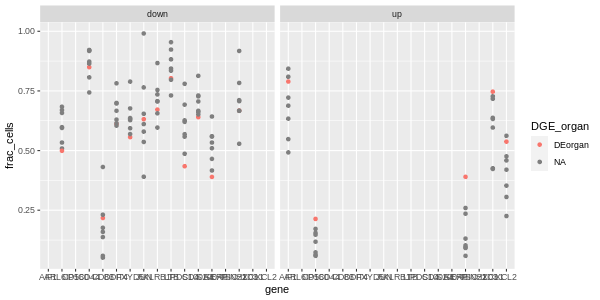

In [377]:
%%R -w 600 -h 300
c_fracs %>%
    rownames_to_column("pair") %>%
    pivot_longer(cols=-pair, names_to="gene", values_to="frac_cells") %>%
#     filter(gene=='XIST') %>%
    separate('pair', into=c("organ", "celltype"), sep="-") %>%
    mutate(DGE_organ = ifelse(organ==de_org, "DEorgan", NA)) %>%
    mutate(gene_up = ifelse(gene %in% gs_up, "up", 'down')) %>%
    ggplot(aes(gene, frac_cells, color=DGE_organ)) +
#     geom_boxplot() +
    geom_point() +
#     geom_line(aes(group=gene)) +
    facet_wrap(gene_up ~ .) +
    scale_fill_viridis_c()

### Signatures - scanpy way

In [87]:
adata_lymph_all.var_names_make_unique()

In [171]:
def get_DGE_score(adata_lymph_all, de_res, ct, org):
    ## Get DE genes for celltype-organ pair
    gs_up = get_de_genes(de_res, ct, org, select_genes="up")
    gs_down = get_de_genes(de_res, ct, org, select_genes="down")

    ## Summarize gene expression score
    sc.tl.score_genes(adata_lymph_all, gene_list=gs_down, ctrl_size=len(gs_down), score_name="score_down")
    adata_lymph_all.obs["score_down"] = MinMaxScaler().fit_transform(adata_lymph_all.obs["score_down"].values.reshape(-1,1))
    sc.tl.score_genes(adata_lymph_all, gene_list=gs_up, ctrl_size=len(gs_up), score_name="score_up")
    adata_lymph_all.obs["score_up"] = MinMaxScaler().fit_transform(adata_lymph_all.obs["score_up"].values.reshape(-1,1))

    ## Get one score
    score_name = 'sig_score_' + org + "_" + ct
    adata_lymph_all.obs[score_name] = adata_lymph_all.obs["score_up"] - adata_lymph_all.obs["score_down"]

In [127]:
adata_lymph_all.obs["organ_anno_lvl_2"] = adata_lymph_all.obs["organ"].astype("str") + "_" + adata_lymph_all.obs["anno_lvl_2"].astype("str")

In [194]:
for ct,org in de_res[["celltype", "organ"]].drop_duplicates().values:
    n_de_genes_up = len(get_de_genes(de_res, ct, org, select_genes="up"))
    n_de_genes_down = len(get_de_genes(de_res, ct, org, select_genes="down"))
    if n_de_genes_up > 10 and n_de_genes_down > 10:
        get_DGE_score(adata_lymph_all, de_res, ct, org)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remo

In [72]:
organs = adata_lymph_all.obs["organ"].unique()
cts = adata_lymph_all.obs["anno_lvl_2"].unique()

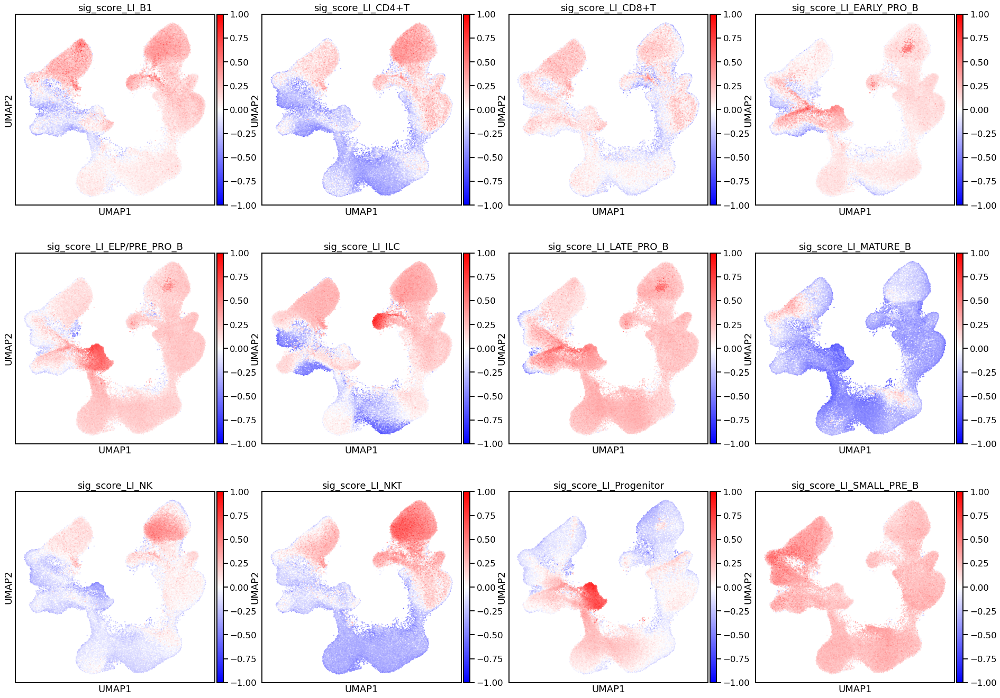

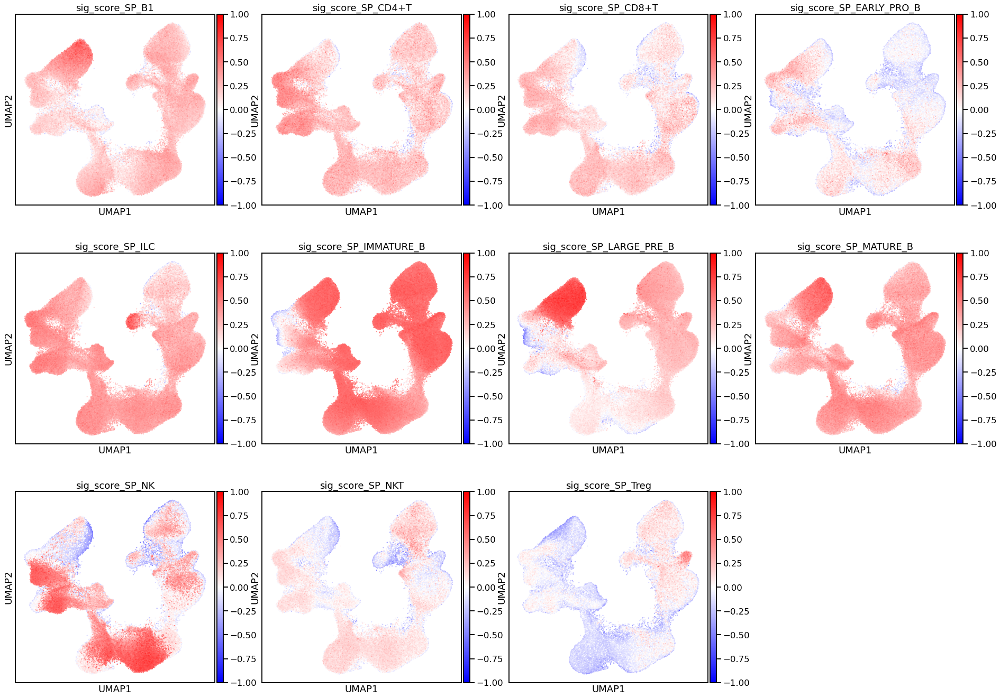

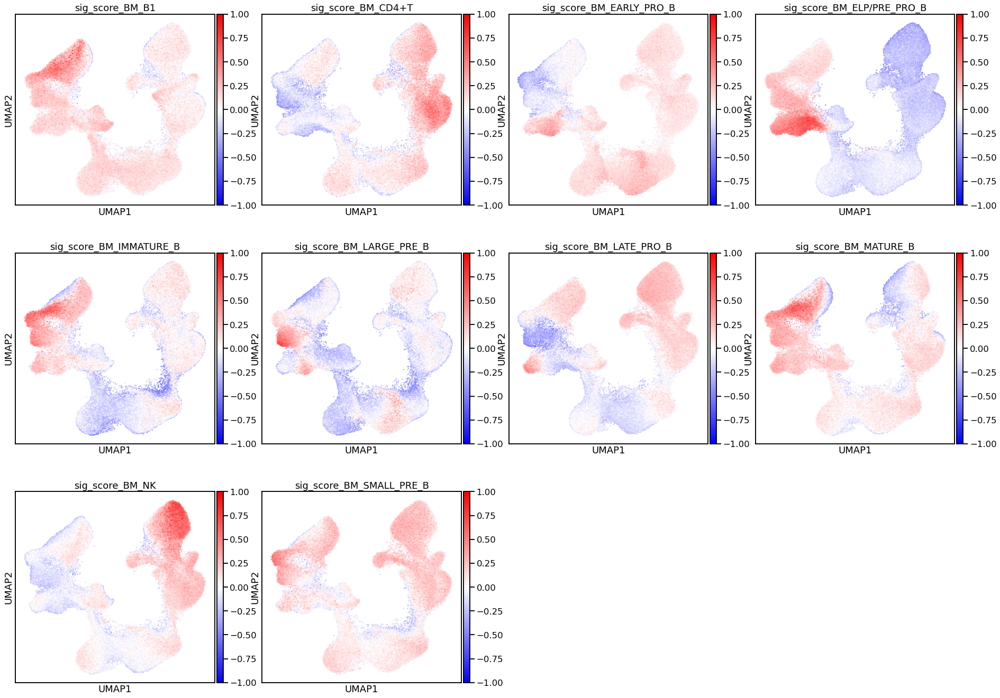

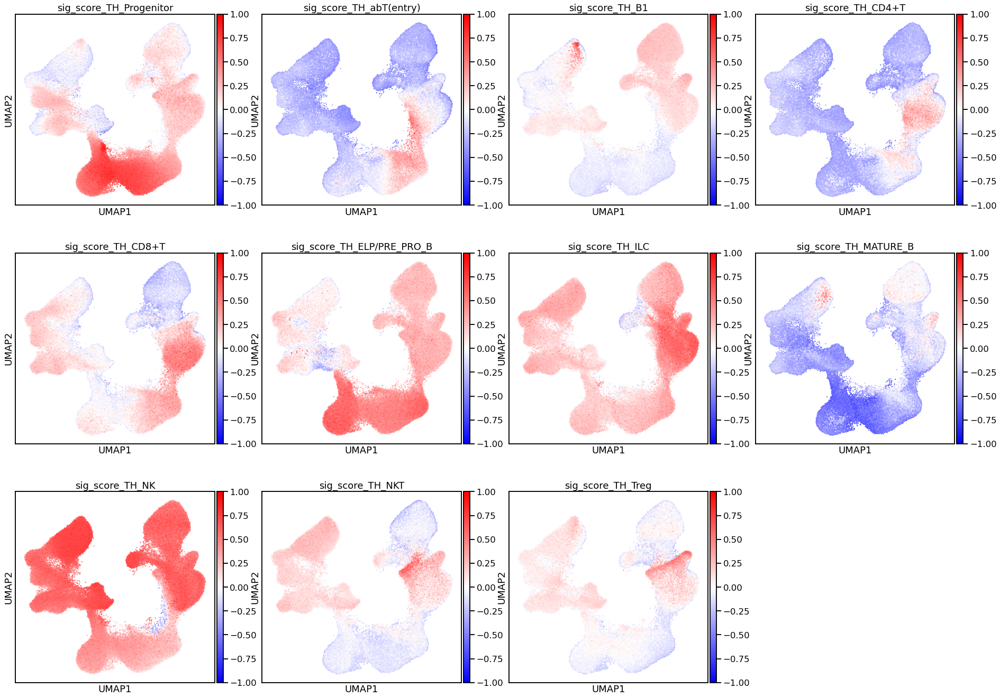

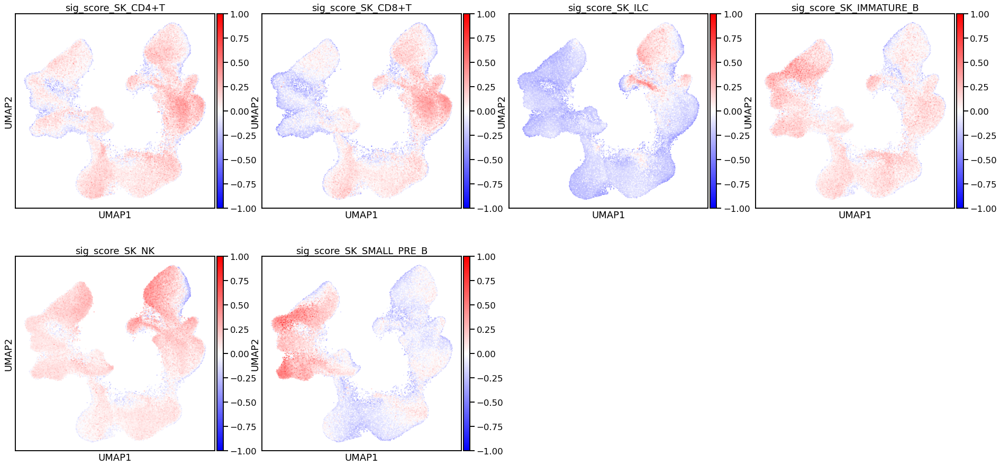

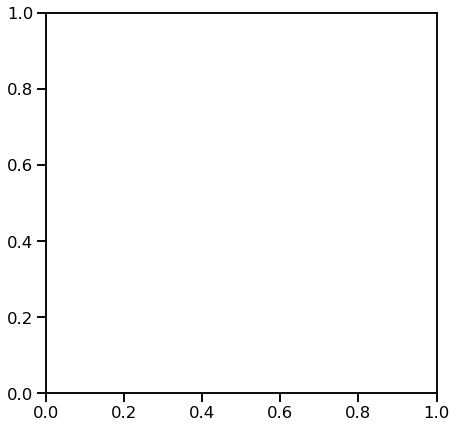

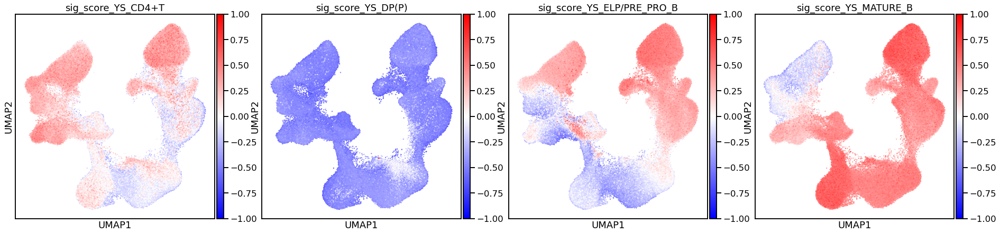

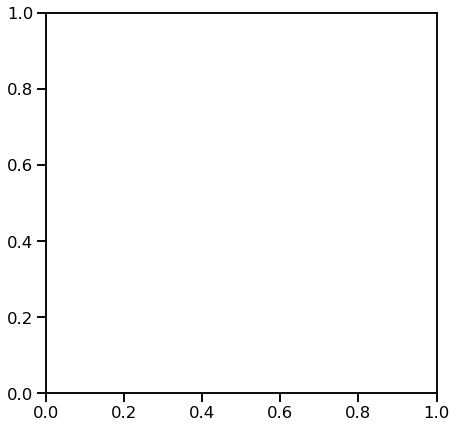

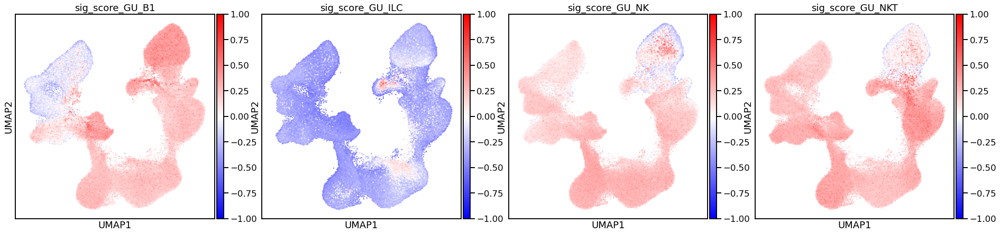

In [200]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")
for o in organs:
    sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_" + o)]
    sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr", vmax=1, vmin=-1)

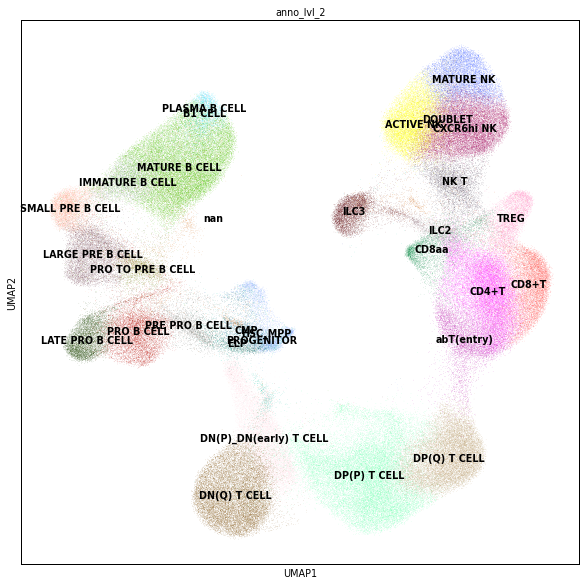

In [197]:
plt.rcParams["figure.figsize"] = [10,10]
sns.set_context("paper")
sc.pl.umap(adata_lymph_all, color="anno_lvl_2", legend_loc="on data")

In [204]:
## Save signature scores
sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_")]
adata_lymph_all.obs[sig_scores_cols].to_csv("/nfs/team205/ed6/data/Fetal_immune/LMM_lymph_signatures_scores.csv")

In [212]:
sign_cormat = np.corrcoef(adata_lymph_all.obs[sig_scores_cols].T)

In [241]:
lut_organ = dict(zip(organs, adata_lymph_all.uns["organ_colors"]))
lut_ct = dict(zip(cts, adata_lymph_all.uns["anno_lvl_2_colors"]))

In [242]:
row_colors_org = pd.Series([x.split("_")[2] for x in sig_scores_cols]).map(lut_organ)
row_colors_org.index = sig_scores_cols
# row_colors_ct = pd.Series([x.split("_")[2:] for x in sig_scores_cols]).map(lut_ct)

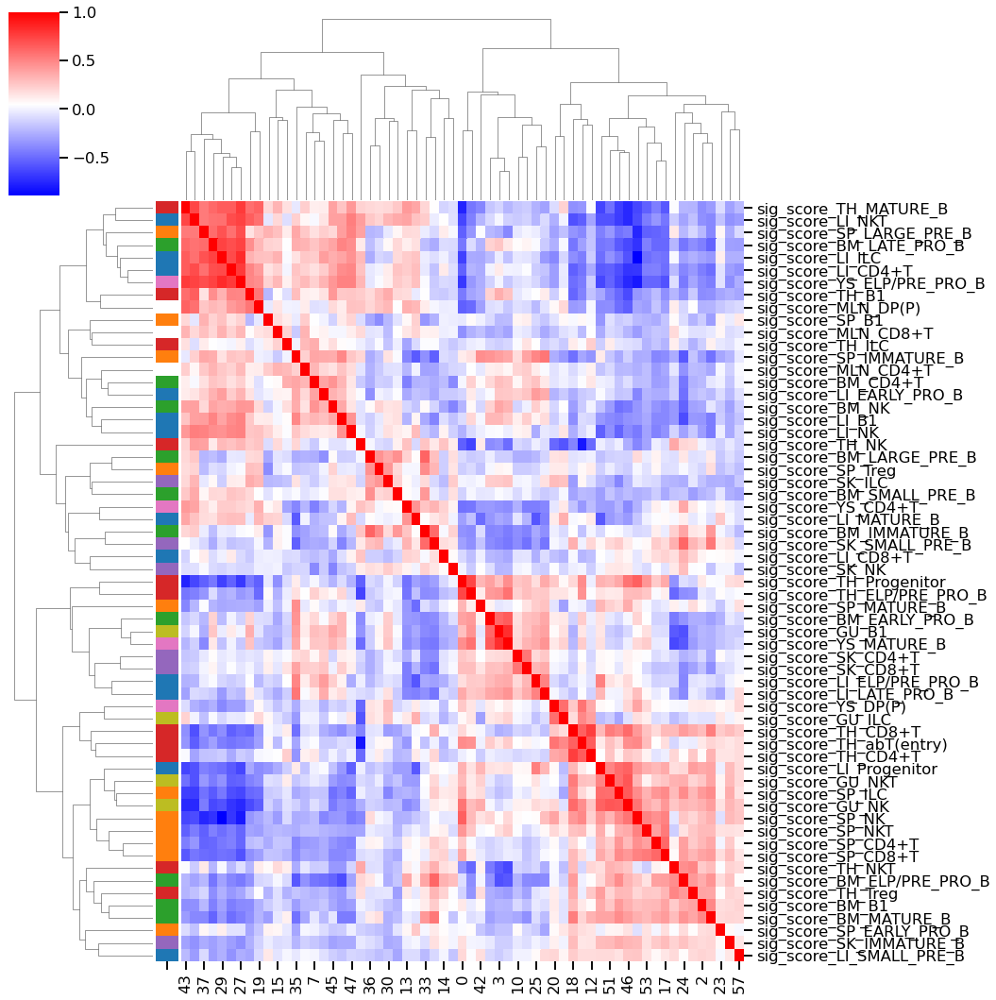

In [248]:
sns.clustermap(pd.DataFrame(sign_cormat, index=sig_scores_cols), cmap="bwr", row_colors=row_colors_org, figsize=[15,15], yticklabels=True)

In [15]:
sig_scores = pd.read_csv("/nfs/team205/ed6/data/Fetal_immune/LMM_lymph_signatures_scores.csv", index_col=0)

In [184]:
sig_scores

NameError: name 'sig_scores' is not defined

In [20]:
adata_lymph.obs["sig_score_TH_CD4+T"] = sig_scores.loc[adata_lymph.obs_names,"sig_score_TH_CD4+T"].values

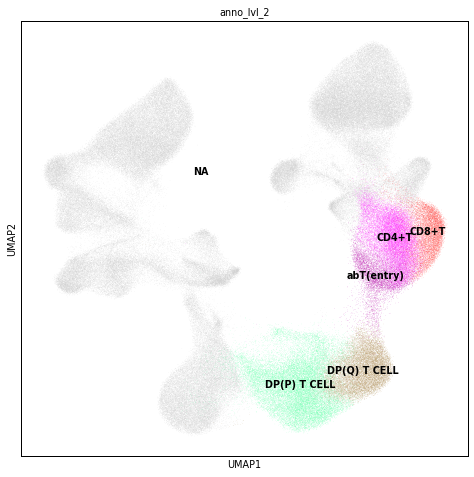

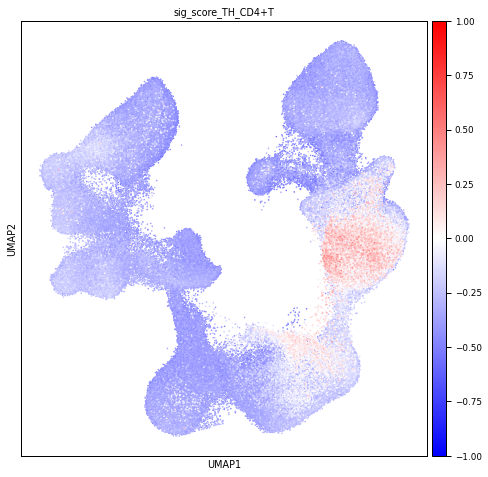

In [33]:
plt.rcParams["figure.figsize"] = [8,8]
sns.set_context("paper");
sc.pl.umap(adata_lymph, color=["anno_lvl_2"], legend_loc='on data', groups=["abT(entry)", "CD4+T","CD8+T", "DP(Q) T CELL", "DP(P) T CELL"])
sc.pl.umap(adata_lymph, color="sig_score_TH_CD4+T", size=10, cmap="bwr", vmax=1, vmin=-1)

### Make signature from regression coefs

... storing 'anno_lvl_1' as categorical
... storing 'anno_lvl_2' as categorical


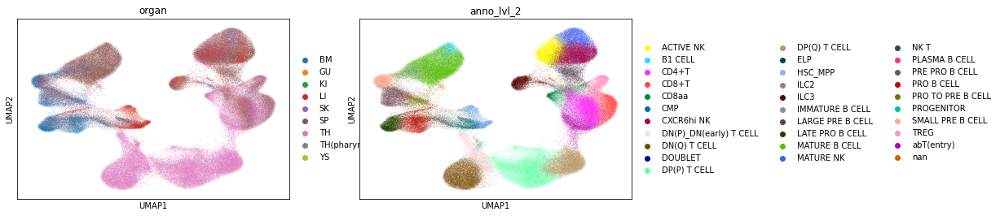

In [17]:
sc.pl.umap(adata_lymph_all, color=["organ", "anno_lvl_2"])

In [18]:
lmm_coefs = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/significant_genes/LMM_Natsuhiko_results/de_lymphoid_ltsr0.9.beta.csv")

In [171]:
de_res["name"] = de_res["celltype"] + "_" + de_res["organ"]
de_res[["name", "gene"]]

,name,gene
0,abT(entry)_BM,ACP5
1,abT(entry)_GU,MT-CO2
2,abT(entry)_MLN,FAM134B
3,abT(entry)_MLN,TCF7
4,abT(entry)_SK,NBEAL1
...,...,...
14471,Treg_TH,IL32
14472,Treg_YS,HLA-DMA
14473,Treg_YS,HLA-DPB1
14474,Treg_YS,RP11-138A9.2


In [19]:
genes = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/significant_genes/LMM_Natsuhiko_results/de_lymphoid_ltsr0.9.genes.csv")["GeneName"]

lmm_coefs.index = genes

lmm_coefs.columns = ["_".join(x.split(":")) for x in lmm_coefs.columns]

--> TODO

In [180]:
de_res[de_res.name=="n"]

,celltype,organ,gene,ltsr,logFoldChange,BM,GU,KI,LI,MLN,SK,SP,TH,YS,name


In [196]:
## Set coef to 0 if gene is not significantly DE
for n in de_res["name"].unique():
    de_genes = de_res[de_res.name==n].gene
    de_genes = de_genes[de_genes.isin(lmm_coefs.index)]
    lmm_coefs.loc[~lmm_coefs.index.isin(de_genes),n] = 0
#     # print(org)
#     print(de_res[(de_res.organ==org) & (de_res.celltype==ct)].gene)

In [20]:
adata_lymph_all.var_names_make_unique()

In [31]:
# X_mat = adata_lymph_all[:,genes].X

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [21]:
sc.pp.scale(adata_lymph_all, zero_center=False)

In [22]:
X_mat = adata_lymph_all[:,genes].X

In [197]:
coefs_signatures = X_mat.dot(lmm_coefs)

In [198]:
coefs_signatures = sc.pp.scale(coefs_signatures)

In [199]:
sign_cormat = np.corrcoef(coefs_signatures.T)
sign_cormat = pd.DataFrame(sign_cormat, columns=lmm_coefs.columns, index=lmm_coefs.columns)

In [200]:
sc_sign_scores = pd.read_csv("/nfs/team205/ed6/data/Fetal_immune/LMM_lymph_signatures_scores.csv", index_col=0)

In [201]:
# keep_pairs = [x.split('sig_score_')[1] for x in sc_sign_scores.columns]
keep_pairs = ["_".join(x.split('sig_score_')[1].split("_")[1:]) + "_" + x.split('sig_score_')[1].split("_")[0] for x in sc_sign_scores.columns]

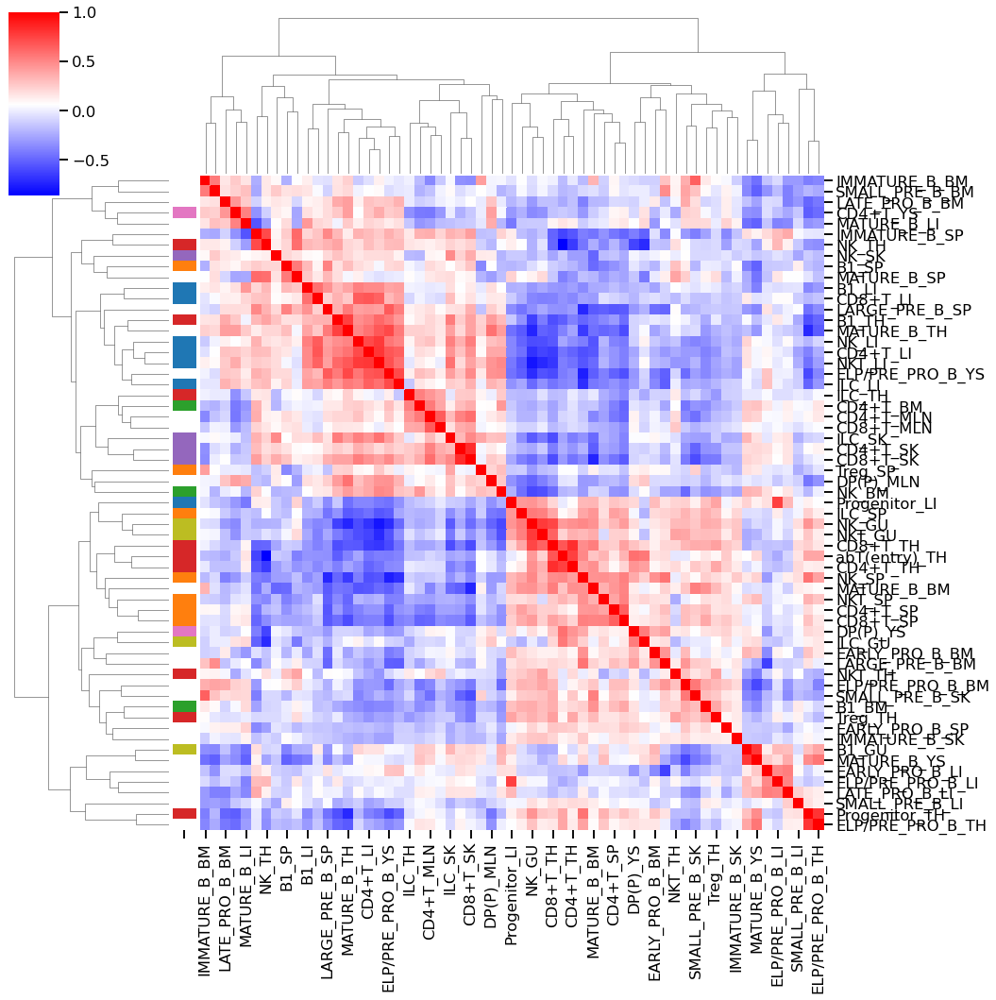

In [202]:
organs = adata_lymph_all.obs["organ"].unique()
cts = adata_lymph_all.obs["anno_lvl_2"].unique()

sig_scores_cols = keep_pairs

lut_organ = dict(zip(organs, adata_lymph_all.uns["organ_colors"]))
lut_ct = dict(zip(cts, adata_lymph_all.uns["anno_lvl_2_colors"]))

row_colors_org = pd.Series([x.split("_")[1] for x in sig_scores_cols]).map(lut_organ)
row_colors_org.index = sig_scores_cols
# row_colors_ct = pd.Series([x.split("_")[2:] for x in sig_scores_cols]).map(lut_ct)

sns.clustermap(pd.DataFrame(sign_cormat.loc[keep_pairs, keep_pairs], index=sig_scores_cols), cmap="bwr", row_colors=row_colors_org, figsize=[15,15], yticklabels=True)

In [203]:
coefs_signatures_df = pd.DataFrame(coefs_signatures, columns=["sig_score_"+x for x in lmm_coefs.columns])
coefs_signatures_df.index = adata_lymph_all.obs_names

# coefs_signatures_df = softmax(coefs_signatures_df, axis=0)

In [204]:
adata_lymph_all.obs = adata_lymph_all.obs.drop(coefs_signatures_df.columns, axis=1)
adata_lymph_all.obs = pd.concat([adata_lymph_all.obs, coefs_signatures_df], 1)

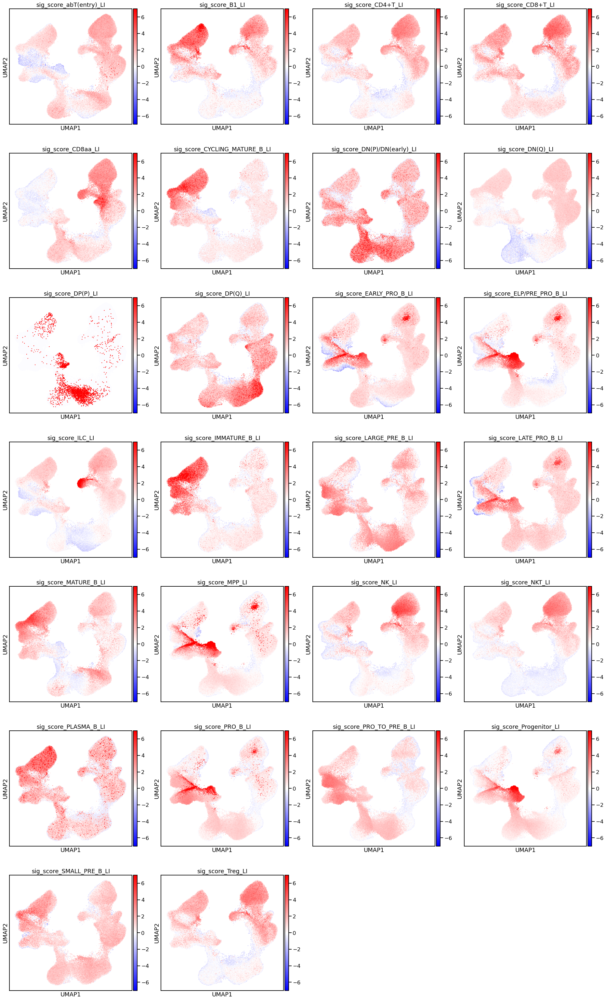

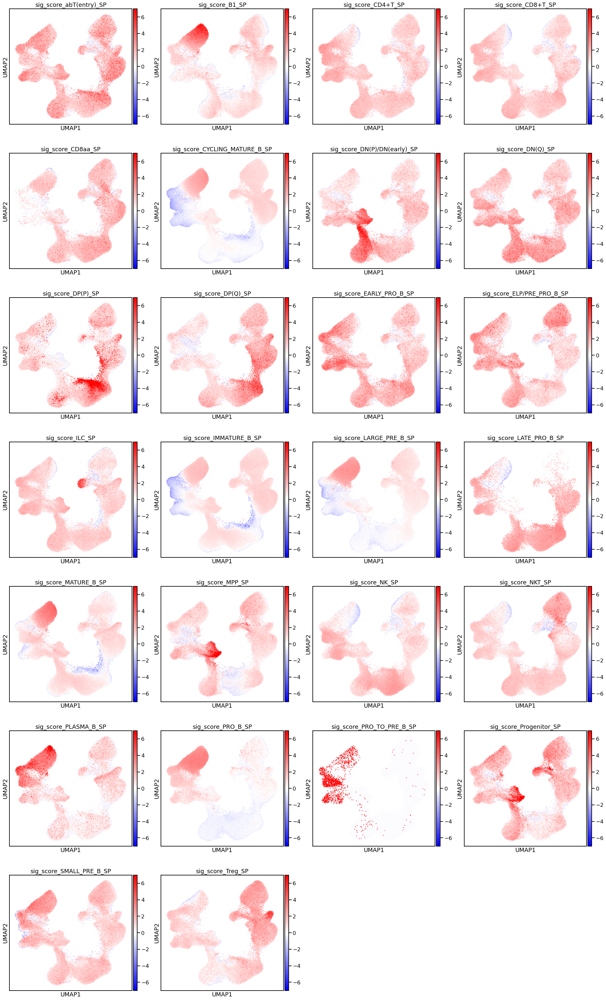

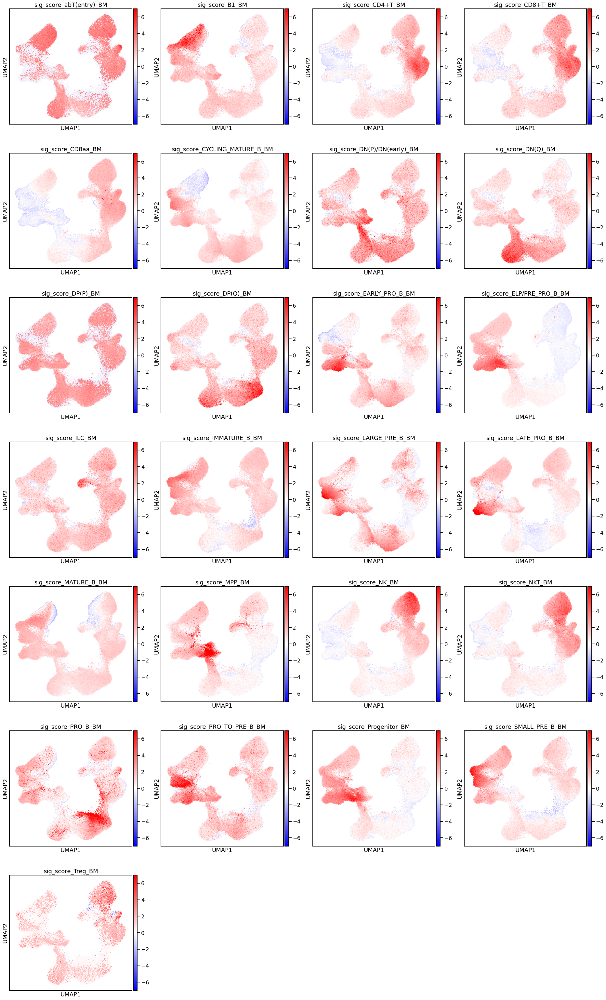

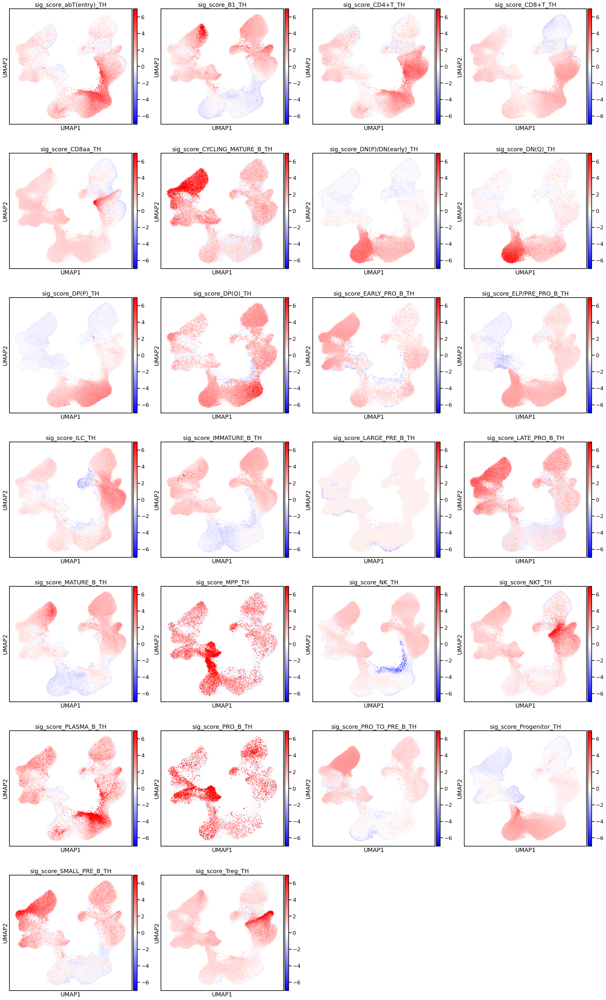

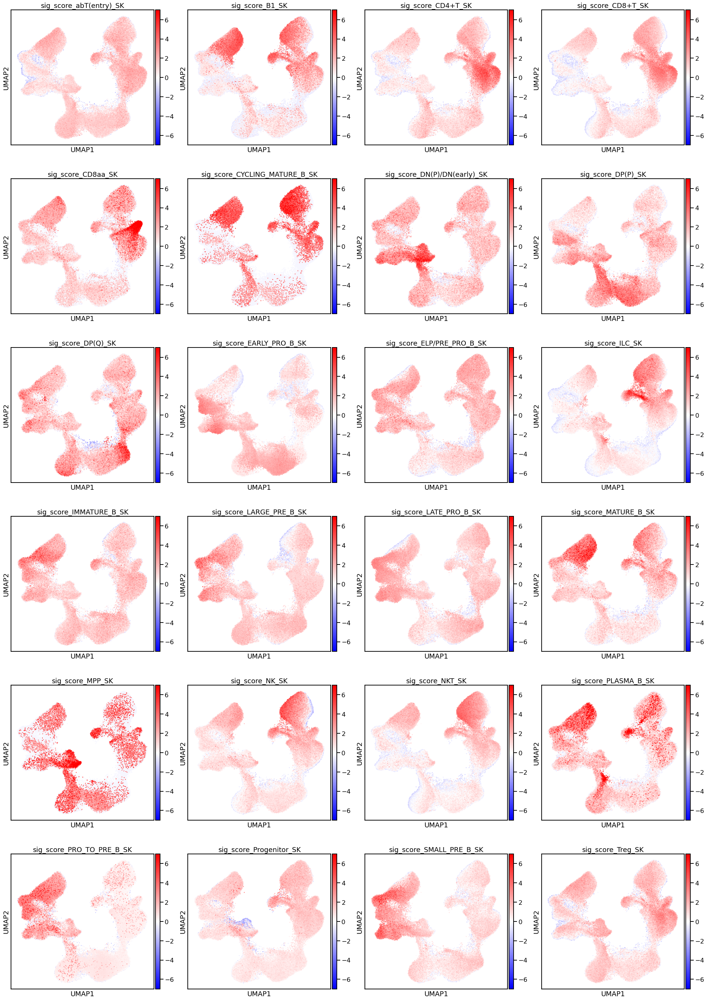

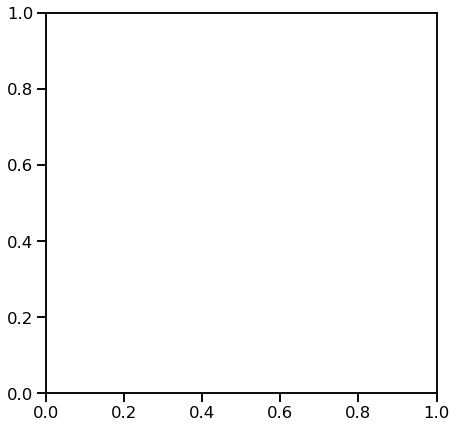

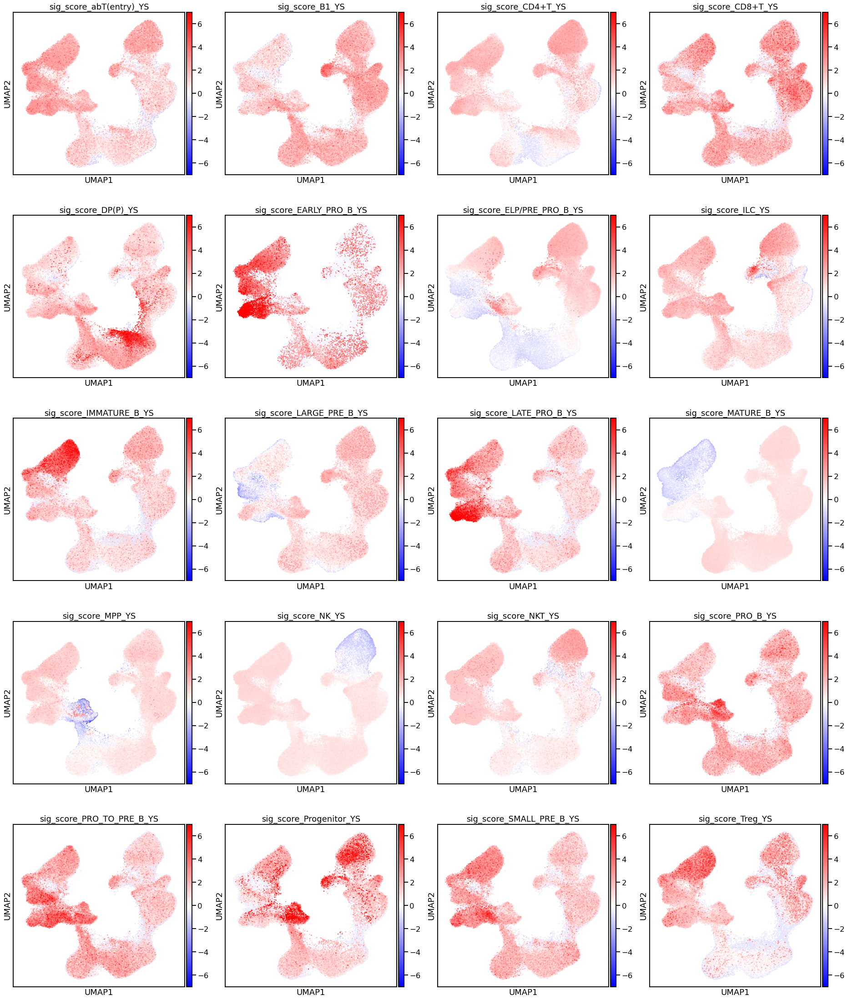

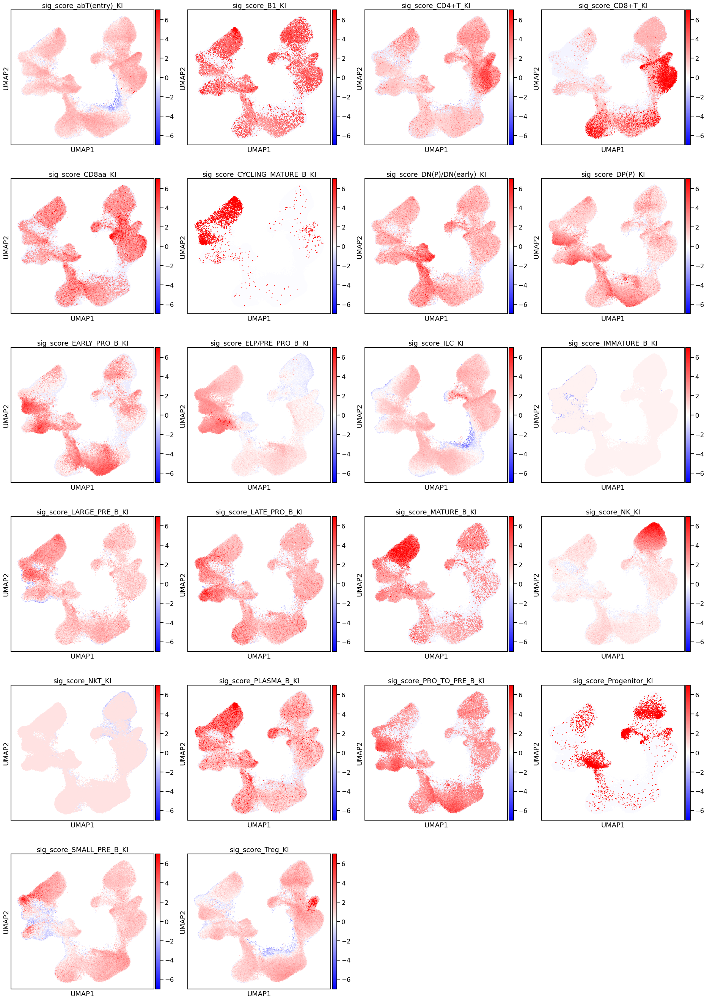

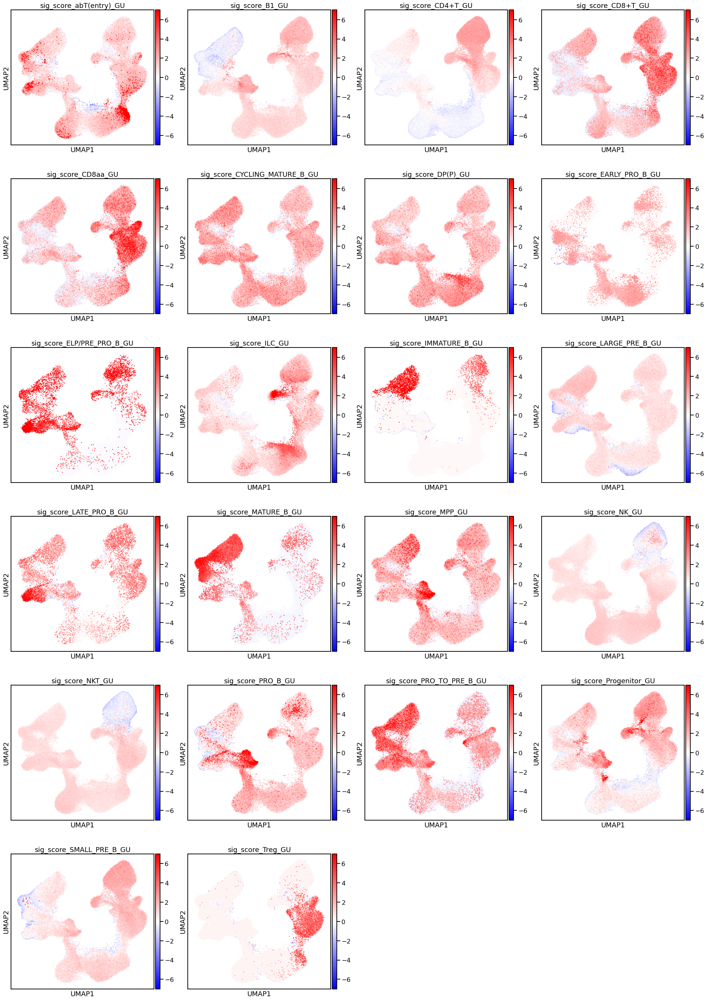

In [206]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")
for o in organs:
    sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_") and x.endswith(o)]
    sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr", vmin=-7, vmax=7)

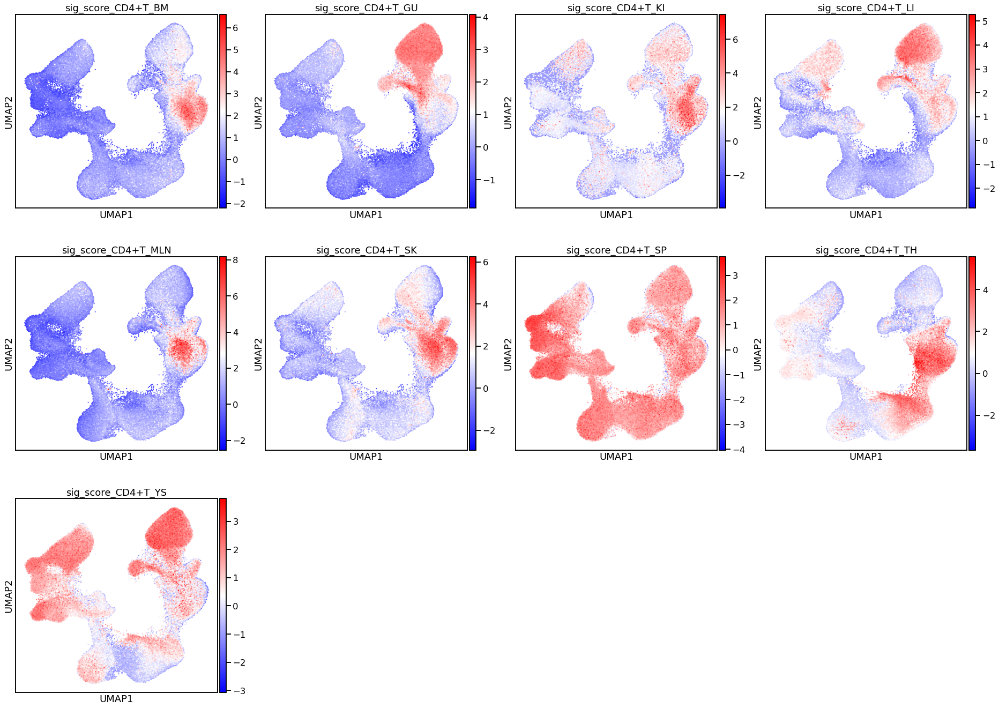

In [244]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")

sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_CD4+T")]
sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr")

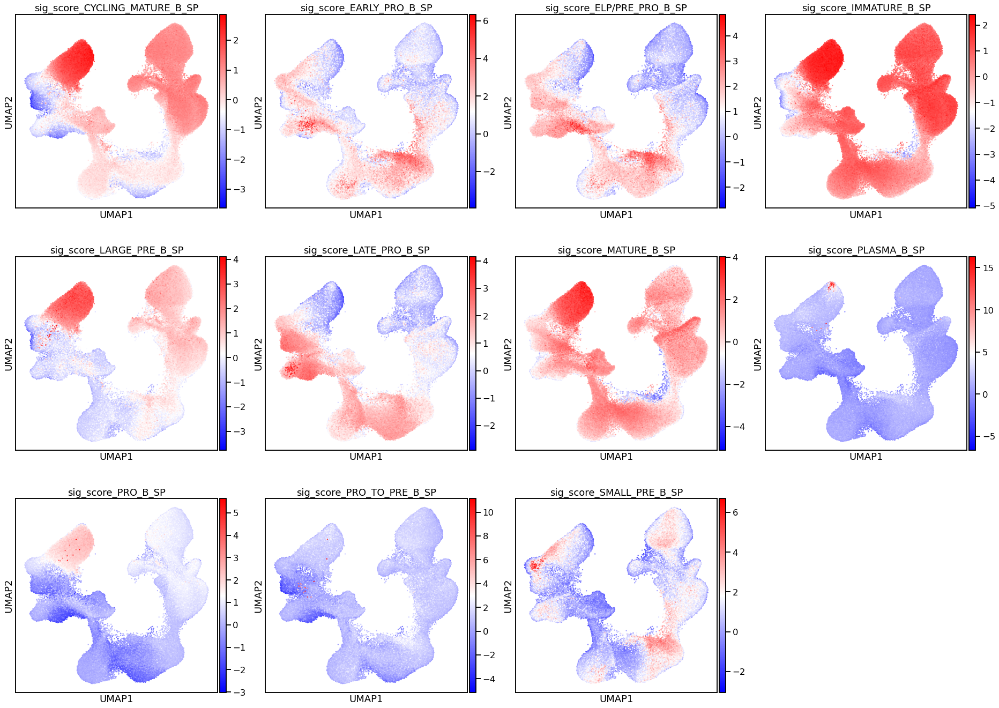

In [158]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")

sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_") and x.endswith("B_SP")]
sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr")

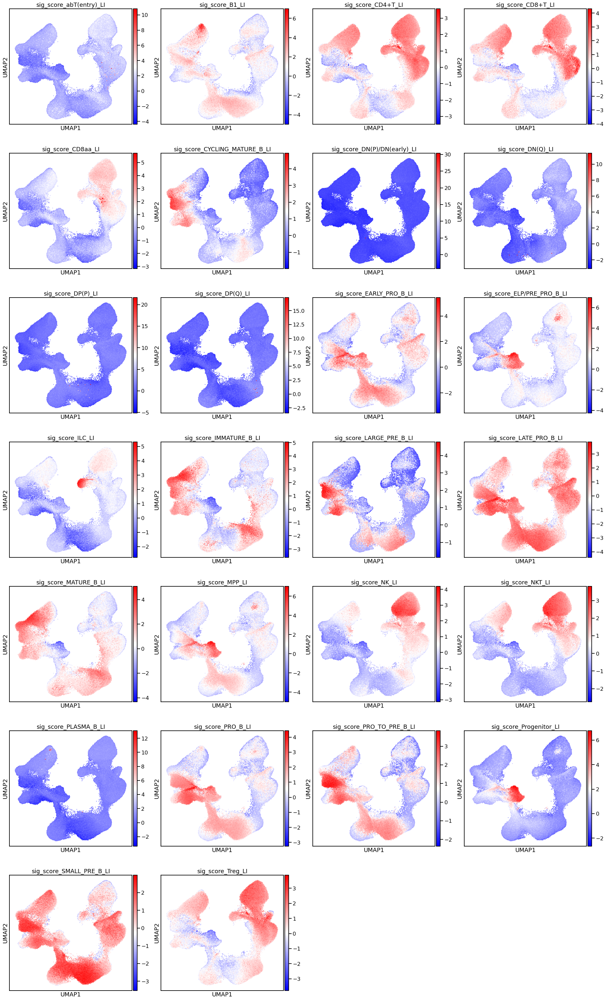

In [139]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")

sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_") and x.endswith("LI")]
sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr")

In [ ]:
plt.rcParams["figure.figsize"] = [7,7]
sns.set_context("talk")

sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_") and x.endswith("LI")]
sc.pl.umap(adata_lymph_all, color=sig_scores_cols, size=20, cmap="bwr")

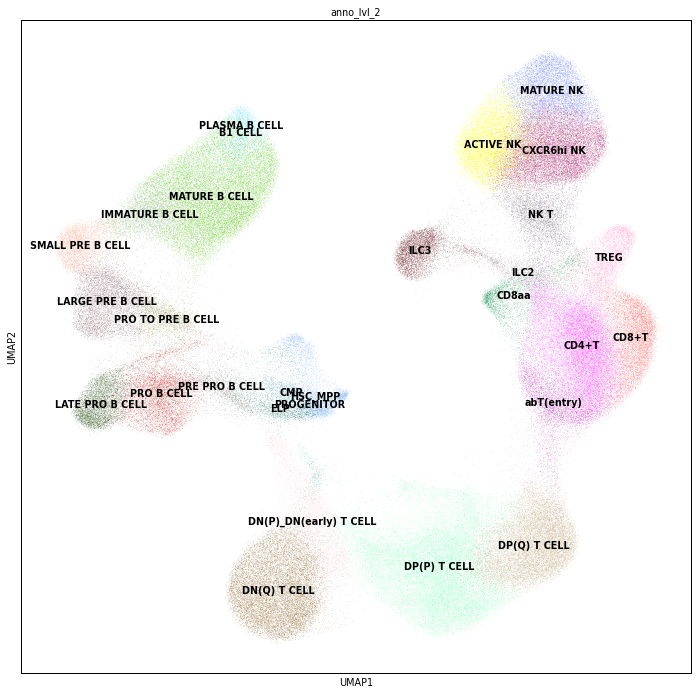

In [268]:
plt.rcParams["figure.figsize"] = [12,12]
sns.set_context("paper")
sc.pl.umap(adata_lymph_all[~adata_lymph_all.obs["anno_lvl_2"].isin(["nan", "DOUBLET"])], color="anno_lvl_2", legend_loc="on data", save="lymhp.png")

In [42]:
adata_lymph_all.obs["celltype"] = anno["anno_lvl_2"]

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


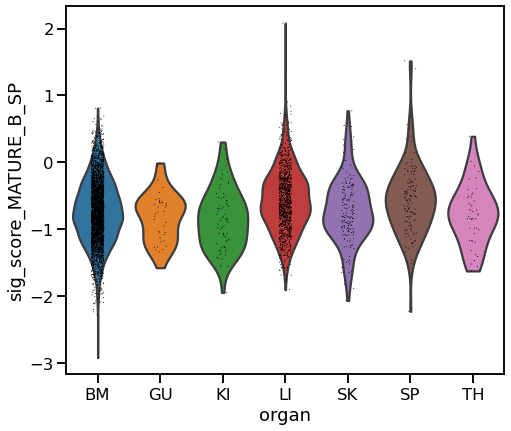

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


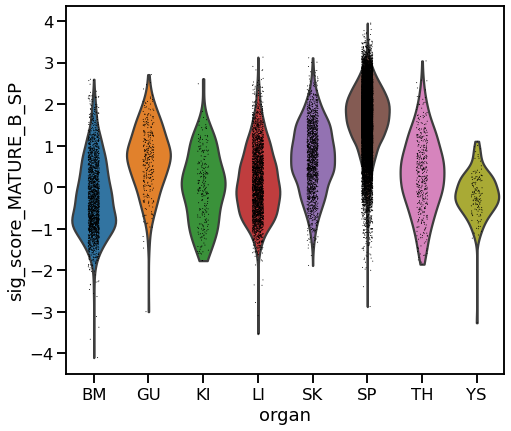

In [67]:
sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.anno_lvl_2=="SMALL PRE B CELL"], "sig_score_MATURE_B_SP", groupby="organ");
sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.anno_lvl_2=="MATURE B CELL"], "sig_score_MATURE_B_SP", groupby="organ");
# sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.anno_lvl_2=="SMALL_PRE_B_CELL"], sig_scores_cols[3:6], groupby="organ");
# sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.anno_lvl_2=="SMALL_PRE_B_CELL"], sig_scores_cols[6:9], groupby="organ");

In [77]:
adata_lymph_all.obs["age"] = adata_lymph[adata_lymph_all.obs_names].obs["age"]

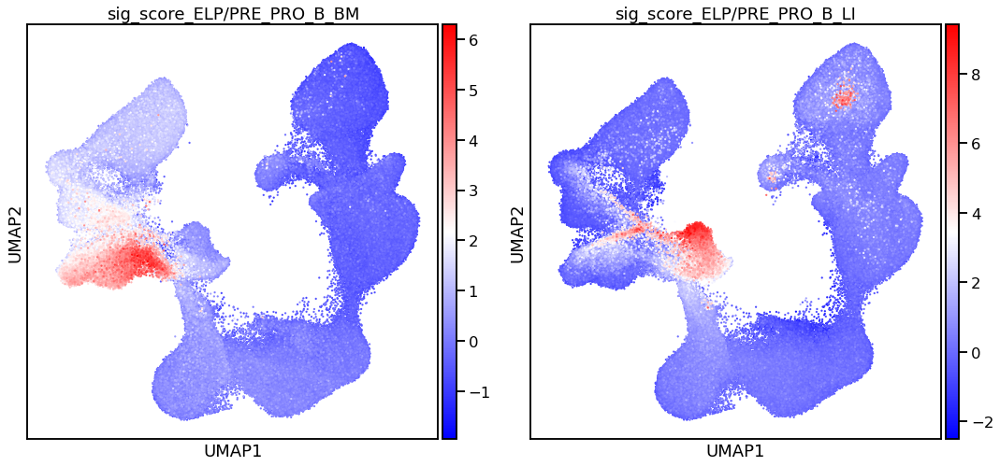

In [273]:
sns.set_context("talk")
plt.rcParams["figure.figsize"] = [8,8]
sc.pl.umap(adata_lymph_all, color=["sig_score_ELP/PRE_PRO_B_BM", "sig_score_ELP/PRE_PRO_B_LI"], size=20, cmap="bwr")

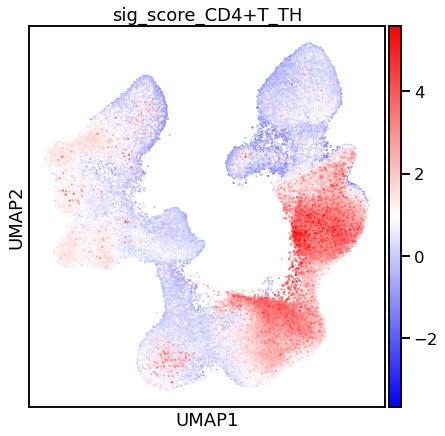

In [246]:
ct = 'MATURE B CELL'
sig = "sig_score_CD4+T_TH"
sc.pl.umap(adata_lymph_all, color=sig, size=20, cmap="bwr")

age_org_sig_df = adata_lymph_all[adata_lymph_all.obs.anno_lvl_2==ct].obs[[sig, "organ","age", "anno_lvl_2"]]
# age_org_sig_df[(age_org_sig_df["organ"] == "BM") & (age_org_sig_df["age"] == '7')]
df = age_org_sig_df.groupby(["organ", "age", "anno_lvl_2"])


In [248]:

age_org_sig_df = adata_lymph_all.obs[[sig, "organ","age", "anno_lvl_2"]]
# age_org_sig_df[(age_org_sig_df["organ"] == "BM") & (age_org_sig_df["age"] == '7')]
df = age_org_sig_df.groupby(["organ", "age", "anno_lvl_2"])


In [249]:
%%R -w 1000 -h 400 -i age_org_sig_df
dim(age_org_sig_df)

[1] 244709      4


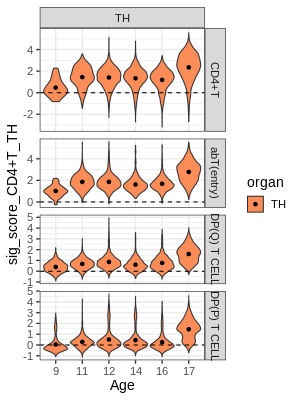

In [254]:
%%R -w 300 -h 400 -i sig
age_org_sig_df %>%
    mutate(organ=factor(organ, levels=order_organs)) %>%
    filter(anno_lvl_2 %in% c("CD4+T", 'abT(entry)',"DP(Q) T CELL", "DP(P) T CELL")) %>%
    mutate(anno_lvl_2 = factor(anno_lvl_2, levels=c("CD4+T", 'abT(entry)',"DP(Q) T CELL", "DP(P) T CELL"))) %>%
    filter(organ == 'TH') %>%
    rename(sig=sig) %>%
    group_by(organ, age, anno_lvl_2) %>%
    mutate(mean_sig=mean(sig)) %>%
    ggplot(aes(as.factor(age),sig, fill=organ)) + 
    geom_violin(scale="width")  +
    geom_point(data = . %>% distinct(age,organ, mean_sig,anno_lvl_2),aes(y=mean_sig)) +
    facet_grid(anno_lvl_2~organ, scales="free", space="free") +
    geom_hline(linetype=2, yintercept=0) +
    scale_fill_brewer(palette="Spectral") +
    ylab(sig) + xlab("Age") +
#     ggtitle(unique(age_org_sig_df$anno_lvl_2)) +
    theme_bw(base_size=14)

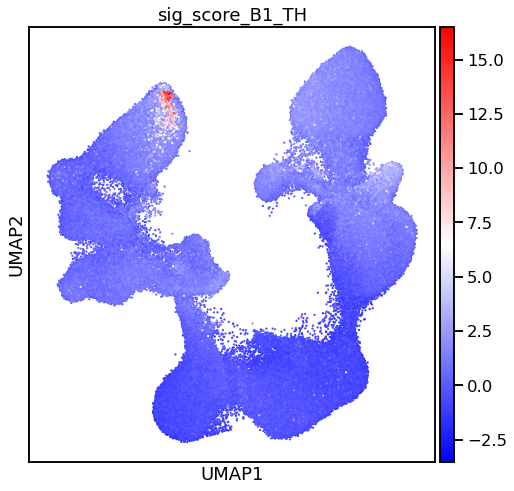

In [291]:
sig = "sig_score_B1_TH"
sc.pl.umap(adata_lymph_all, color=sig, size=20, cmap="bwr")

age_org_sig_df = adata_lymph_all[adata_lymph_all.obs.anno_lvl_2==ct].obs[[sig, "organ","age", "anno_lvl_2"]]
# age_org_sig_df[(age_org_sig_df["organ"] == "BM") & (age_org_sig_df["age"] == '7')]
df = age_org_sig_df.groupby(["organ", "age", "anno_lvl_2"])


In [292]:
age_org_sig_df = adata_lymph_all.obs[[sig, "organ","age", "anno_lvl_2"]]
# age_org_sig_df[(age_org_sig_df["organ"] == "BM") & (age_org_sig_df["age"] == '7')]
df = age_org_sig_df.groupby(["organ", "age", "anno_lvl_2"])

In [293]:
%%R -w 1000 -h 400 -i age_org_sig_df
dim(age_org_sig_df)

[1] 244709      4


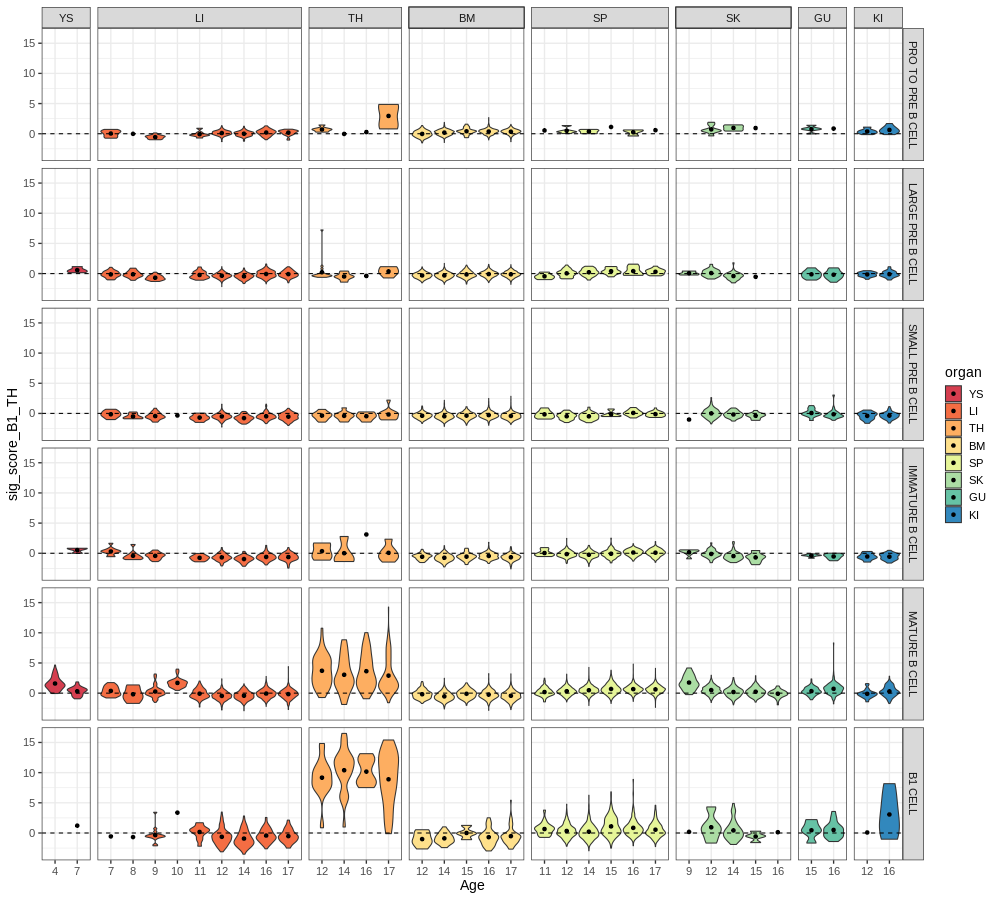

In [295]:
%%R -w 1000 -h 900 -i sig
age_org_sig_df %>%
    mutate(organ=factor(organ, levels=order_organs)) %>%
    filter(anno_lvl_2 %in% c("PRO TO PRE B CELL","LARGE PRE B CELL","SMALL PRE B CELL","IMMATURE B CELL","MATURE B CELL", "B1 CELL")) %>%
    mutate(anno_lvl_2 = factor(anno_lvl_2, levels=c("PRO TO PRE B CELL","LARGE PRE B CELL","SMALL PRE B CELL","IMMATURE B CELL","MATURE B CELL", "B1 CELL"))) %>%
    rename(sig=sig) %>%
    group_by(organ, age, anno_lvl_2) %>%
    mutate(mean_sig=mean(sig)) %>%
    ggplot(aes(as.factor(age),sig, fill=organ)) + 
    geom_violin(scale="width")  +
#     geom_jitter(size=0.01, alpha=0.5) +
    geom_point(data = . %>% distinct(age,organ, mean_sig,anno_lvl_2),aes(y=mean_sig)) +
    facet_grid(anno_lvl_2~organ, scales="free_x", space="free_x") +
    geom_hline(linetype=2, yintercept=0) +
    scale_fill_brewer(palette="Spectral") +
    ylab(sig) + xlab("Age") +
#     ggtitle(unique(age_org_sig_df$anno_lvl_2)) +
    theme_bw(base_size=14)

In [161]:
treg_cols = [x for x in sign_cormat.columns if "Treg" in x]

sns.clustermap(sign_cormat.loc[treg_cols, treg_cols], cmap="bwr", row_colors=row_colors_org, figsize=[6,6], yticklabels=True)

Trying to set attribute `.obs` of view, copying.
... storing 'celltype' as categorical


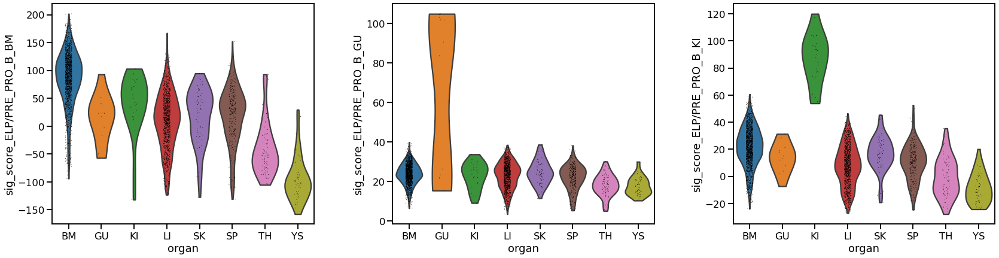

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'celltype' as categorical


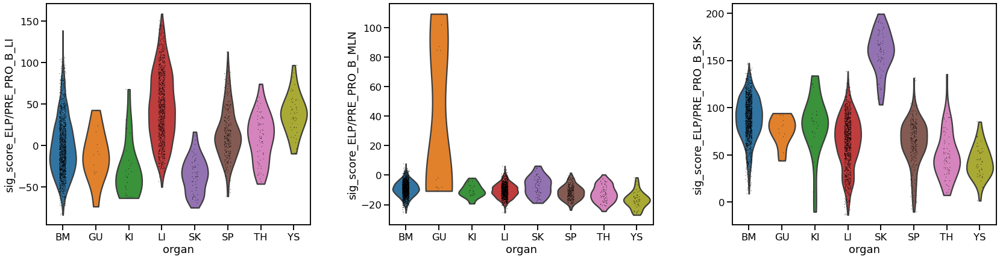

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'celltype' as categorical


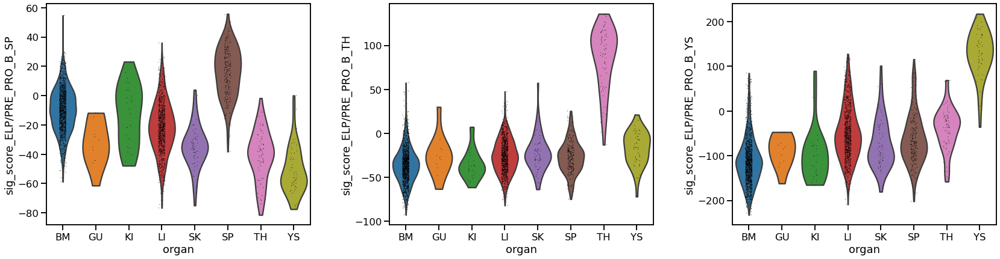

In [165]:
sig_scores_cols = [x for x in adata_lymph_all.obs.columns if x.startswith("sig_score_" + "ELP/PRE_PRO_B")]
sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.celltype=="ELP/PRE_PRO_B"], sig_scores_cols[0:3], groupby="organ");
sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.celltype=="ELP/PRE_PRO_B"], sig_scores_cols[3:6], groupby="organ");
sc.pl.violin(adata_lymph_all[adata_lymph_all.obs.celltype=="ELP/PRE_PRO_B"], sig_scores_cols[6:9], groupby="organ");

---

## Load data + annotations

In [15]:
adata_full_raw = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [17]:
def _rename_gut_cells(x):
    if "FCA" not in x:
        x = x.split("_")[8].split('-')[1] + "-1"  + "_" + "_".join(x.split("_")[3:6])
    else: 
        x = x.split("_")[7].split('-')[1] + "-1" + "_" + "_".join(x.split("_")[3:5]) 
    return(x)

obs_names = adata_full_raw.obs_names.values
gut_ixs = np.where(adata_full_raw.obs.organ=="GU")[0]
for i in gut_ixs:
    obs_names[i] = _rename_gut_cells(obs_names[i])

adata_full_raw.obs_names = obs_names

In [270]:
adata_nkt = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.NKT_CLEAN.batchCorrected.h5ad")

ERROR! Session/line number was not unique in database. History logging moved to new session 95


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [3]:
adata_b = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.B_CLEAN.batchCorrected.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [13]:
adata_nkt_raw = adata_full_raw[adata_nkt.obs_names,]

In [19]:
adata_b_raw = adata_full_raw[adata_b.obs_names,]

In [20]:
adata_b_raw.obs = adata_b.obs.copy()
adata_b_raw.obsm = adata_b.obsm.copy()
adata_b_raw.obsp = adata_b.obsp.copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [21]:
adata_b_raw.write_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.B_CLEAN_CLEAN.h5ad")

In [14]:
# adata_nkt_raw.write_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.NKT_CLEAN.h5ad")

In [ ]:
# adata_nkt_raw = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.NKT_CLEAN.h5ad")
adata_nkt_raw = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.NKT_CLEAN.h5ad")

In [4]:
adata_nkt_raw.obsm = adata_nkt.obsm
adata_nkt_raw.uns = adata_nkt.uns
adata_nkt_raw.obsp = adata_nkt.obsp
adata_nkt_raw.obs = adata_nkt.obs

In [2]:
adata_b_raw = sc.read_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.B_CLEAN_CLEAN.h5ad")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [3]:
anno_b = pd.read_csv("../manual_annotation/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.B_CLEAN_CLEAN.batchCorrected_annotation.csv", index_col=0)

In [ ]:
anno_nkt = pd.read_csv("../manual_annotation/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.NKT_CLEAN.batchCorrected_annotation.csv")
anno_nkt.index = anno_nkt['index']

In [6]:
adata_nkt_raw.obs = pd.concat([adata_nkt_raw.obs, anno_nkt], axis=1).loc[adata_nkt_raw.obs_names]

In [4]:
adata_b_raw.obs = pd.concat([adata_b_raw.obs, anno_b], axis=1).loc[adata_b_raw.obs_names]

In [70]:
adata_nkt_raw.var_names_make_unique()
adata_nkt.var_names_make_unique()

NameError: name 'adata_nkt_raw' is not defined

In [5]:
adata_b_raw.var_names_make_unique()
# adata_b.var_names_make_unique()

### GLMGamPoi

Following vignette at https://bioconductor.org/packages/release/bioc/vignettes/glmGamPoi/inst/doc/glmGamPoi.html#example

In [8]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [9]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

Activate the anndata2ri conversion between SingleCellExperiment and AnnData

In [10]:
anndata2ri.activate()

In [11]:
%load_ext rpy2.ipython

In [80]:
%%R
# library(tidyverse)
library(ggplot2)
library(glmGamPoi)
library(SingleCellExperiment)

Take a subset of genes

In [72]:
adata_sub = adata_b_raw[:,["AICDA", "IGHE"]]
# adata_sub = adata_nkt_raw[:,adata_nkt.var_names]
adata_sub

View of AnnData object with n_obs × n_vars = 72035 × 2
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'batch', 'bbk', 'uniform_label', 'uniform_label_expanded_merged', 'uniform_label_lvl0', 'Sample.lanes', 'Sort_id', 'age', 'method', 'sex', 'Processing_method', 'AnnatomicalPart', 'leiden_100', 'leiden_150', 'uniform_label_propagated', 'uniform_label_lvl0_propagated', 'uniform_label_expanded_merged_propagated', 'leiden_150_pred_label', 'leiden_150_pred_label_expanded', 'split_1', 'split_2', 'split_3', 'anno_lvl_1', 'anno_lvl_2', 'anno_lvl_3'
    var: 'GeneName', 'GeneID'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [73]:
adata_sub.obs = adata_sub.obs[["anno_lvl_1", "anno_lvl_2", "anno_lvl_3", "donor", "Sample", "age", "method", "organ"]]

In [74]:
counts = adata_sub.X.toarray()
obs_df = adata_sub.obs

In [75]:
obs_df

,anno_lvl_1,anno_lvl_2,anno_lvl_3,donor,Sample,age,method,organ
index,,,,,,,,
FCAImmP7179363-AAACGGGCATTGAGCT,MATURE B CELL,MATURE B CELL,13-MATURE B CELL,F21,F21_LI_45P,16,3GEX,LI
FCAImmP7179363-AAACGGGTCGGTCTAA,PRO B CELL,PRO B CELL,8-PRO B CELL,F21,F21_LI_45P,16,3GEX,LI
FCAImmP7179363-AAAGATGGTCCTAGCG,MATURE B CELL,IMMATURE B CELL,10-IMMATURE B CELL,F21,F21_LI_45P,16,3GEX,LI
FCAImmP7179363-AAAGCAATCGGCTTGG,MATURE B CELL,MATURE B CELL,14-MATURE B CELL,F21,F21_LI_45P,16,3GEX,LI
FCAImmP7179363-AAAGCAATCGTTTAGG,PRE B CELL,LARGE PRE B CELL,16-LARGE PRE B CELL,F21,F21_LI_45P,16,3GEX,LI
...,...,...,...,...,...,...,...,...
TGACTAGTCTGTCAAG-1_Human_colon_16S7985391,MATURE B CELL,MATURE B CELL,18-MATURE B CELL,F66,F66-FPI-0-SC-1,15,3GEX,GU
TGCGCAGGTCTCCCTA-1_Human_colon_16S7985391,MATURE B CELL,IMMATURE B CELL,10-IMMATURE B CELL,F66,F66-FPI-0-SC-1,15,3GEX,GU
TGCGCAGGTGTTCTTT-1_Human_colon_16S7985391,MATURE B CELL,IMMATURE B CELL,10-IMMATURE B CELL,F66,F66-FPI-0-SC-1,15,3GEX,GU


In [76]:
counts = counts.astype("int")

In [77]:
del adata_sub.uns
del adata_sub.obsp

In [79]:
%%R -i counts -i obs_df
head(counts)

     [,1] [,2]
[1,]    0    0
[2,]    0    0
[3,]    0    0
[4,]    0    0
[5,]    0    0
[6,]    0    0


In [87]:
%%R
sce <- SingleCellExperiment(assays=list(counts=t(counts)), colData=obs_df)
rownames(sce) <- c("AICDA", "IGHE")
sce

class: SingleCellExperiment 
dim: 2 72035 
metadata(0):
assays(1): X
rownames(2): AICDA IGHE
rowData names(0):
colnames(72035): FCAImmP7179363-AAACGGGCATTGAGCT
  FCAImmP7179363-AAACGGGTCGGTCTAA ...
  TGGACGCCAATCTGCA-1_Human_colon_16S7985391
  TGGGCGTCACAGAGGT-1_Human_colon_16S7985391
colData names(8): anno_lvl_1 anno_lvl_2 ... method organ
reducedDimNames(0):
altExpNames(0):


In [112]:
%%R
unique(sce$anno_lvl_2)

 [1] "MATURE B CELL"     "PRO B CELL"        "IMMATURE B CELL"  
 [4] "LARGE PRE B CELL"  "HSC_MPP"           "SMALL PRE B CELL" 
 [7] "PRO TO PRE B CELL" "B1 CELL"           "PRE PRO B CELL"   
[10] "LATE PRO B CELL"   "ELP"               "CMP"              
[13] "PLASMA B CELL"    


In [88]:
%%R
# ## Remove lowly expressed genes 
# min_cells = 10
# adata_sub = adata_sub[rowSums(assay(adata_sub, "X")) > min_cells,]
# assay(adata_sub, "X") <- as.matrix(assay(adata_sub, "X"))

## Rename TH(pharyn) to TH
sce$organ <- ifelse(sce$organ ==  'TH(pharyn)', 'TH', as.character(sce$organ))

# ## Exclude YS and KI
# adata_sub <- adata_sub[,adata_sub$organ!="YS"]
# adata_sub <- adata_sub[,adata_sub$organ!="KI"]

# ## Exclude TH specific cell types
# adata_sub <- adata_sub[,adata_sub$anno_lvl_2 %in% c("DN(P)/DN(early)", "DN(Q)", "DP(Q)", "DP(P)")]

In [177]:
%%R
convert_formula_to_model_matrix <- function(formula, col_data, reference_level=NULL){
  if(! is.null(reference_level)){
    has_ref_level <- vapply(col_data, function(x){
      any(!is.na(x) & x == reference_level)
    }, FUN.VALUE = FALSE)
    if(all(has_ref_level == FALSE)){
      stop("None of the columns contains the specified reference_level.")
    }
    col_data[has_ref_level] <- lapply(col_data[has_ref_level], function(col){
      if(is.character(col)){
        col <- as.factor(col)
      }
      stats::relevel(col, ref = reference_level)
    })
  }
  tryCatch({
    mm <- stats::model.matrix.default(formula, col_data)
  }, error = function(e){
    # Try to extract text from error message
    match <- regmatches(e$message, regexec("object '(.+)' not found", e$message))[[1]]
    if(length(match) == 2){
      stop("Object '", match[2], "' not found. Allowed variables are:\n",
           paste0(colnames(col_data), collapse = ", "))
    }else{
      stop(e$message)
    }
  })

  colnames(mm)[colnames(mm) == "(Intercept)"] <- "Intercept"
  mm
}

m <- convert_formula_to_model_matrix(formula= ~ 1 + organ + anno_lvl_2 + (organ*anno_lvl_2), col_data=colData(sce), reference_level="CMP") 

In [188]:
%%R
## Remove columns that sum to 0 in model matrix (e.g. tissue specific cell types)
is_zero_column <- DelayedMatrixStats::colCounts(m, value = 0) == nrow(m)
        
model_mat <- m[,which(colSums(m) > 3)]
colSums(model_mat)

  [1] 72035   264   507 16478   249  2440 23297   830   495  2310  1641  4295
 [13]  3011  7236  6329 26384    55  2690  8523  2297  5353    16     7   348
 [25]    17    55  1603   107  1240     6    88    17   105  3687     8   304
 [37]   121    10    38   633     7   149  1170    17    22    65  1823    12
 [49]    89   134    33     4    15    14   761    13   125   106    46   144
 [61]   230  2542   161  1602 19144   399   139     9     4    34     7     6
 [73]    21   866     6    59   255    63     9    26    39  1827     6   151
 [85]   202    73     7     5    15   424    13    17    14    13    74  1136
 [97]    26   175   140    47


In [189]:
%%R
fit <- glm_gp(sce, design = model_mat, on_disk = FALSE)
# fit_cd4 <- glm_gp(adata_sub[c("CD8A"),sample(colnames(adata_sub), 1000)], design = ~ 1 + organ + anno_lvl_2, on_disk = FALSE)
# fit_cd8 <- glm_gp(adata_sub[c("CD8A"),], design = ~ 1 + organ + anno_lvl_2, on_disk = FALSE)
summary(fit)

glmGamPoiFit object:
The data had 2 rows and 72035 columns.
A model with 100 coefficient was fitted.

Beta:
            AICDA   IGHE
Intercept  -0.325 -16.17
  organGU -11.710  -2.28
  organKI -11.766  -4.29
...

deviance:
 Min 1st Qu. Median 3rd Qu. Max
 312     340    367     394 421

overdispersion:
   Min 1st Qu. Median 3rd Qu.   Max
 0.319   0.345  0.372   0.398 0.424

Shrunken quasi-likelihood overdispersion:
 Min 1st Qu. Median 3rd Qu. Max
   1       1      1       1   1

size_factors:
   Min 1st Qu. Median 3rd Qu.  Max
 0.001   0.001  0.001   0.001 19.4

Mu:
      Min  1st Qu.   Median 3rd Qu.  Max
 2.97e-18 1.74e-11 0.000168 0.00111 19.3



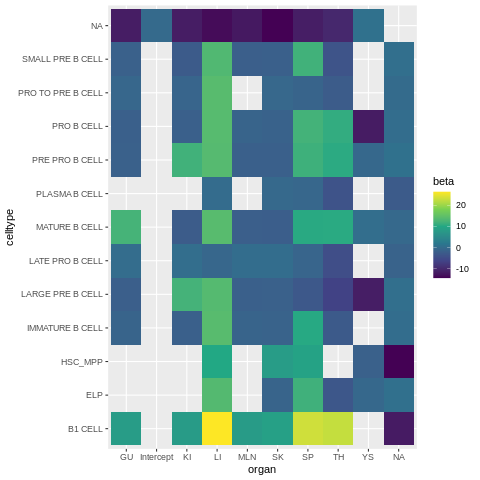

In [207]:
%%R
data.frame(beta=summary(fit)$Beta[1,]) %>%
rownames_to_column() %>%
separate(col=rowname, sep="anno_lvl_2", into=c("organ", "celltype")) %>%
    mutate(organ=str_remove(organ, "organ") %>% str_remove("\\:")) %>%
    mutate(organ=ifelse(organ=="", NA, organ)) %>%
    ggplot(aes(organ, celltype, fill=beta)) +
    geom_tile() +
    scale_fill_viridis_c()

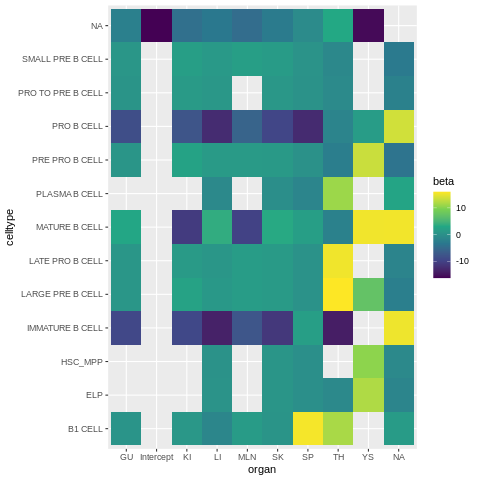

In [208]:
%%R
data.frame(beta=summary(fit)$Beta[2,]) %>%
rownames_to_column() %>%
separate(col=rowname, sep="anno_lvl_2", into=c("organ", "celltype")) %>%
    mutate(organ=str_remove(organ, "organ") %>% str_remove("\\:")) %>%
    mutate(organ=ifelse(organ=="", NA, organ)) %>%
    ggplot(aes(organ, celltype, fill=beta)) +
    geom_tile() +
    scale_fill_viridis_c()

In [251]:
%%R
colnames(fit$Beta)

  [1] "Intercept"                          
  [2] "organGU"                            
  [3] "organKI"                            
  [4] "organLI"                            
  [5] "organMLN"                           
  [6] "organSK"                            
  [7] "organSP"                            
  [8] "organTH"                            
  [9] "organYS"                            
 [10] "anno_lvl_2B1 CELL"                  
 [11] "anno_lvl_2ELP"                      
 [12] "anno_lvl_2HSC_MPP"                  
 [13] "anno_lvl_2IMMATURE B CELL"          
 [14] "anno_lvl_2LARGE PRE B CELL"         
 [15] "anno_lvl_2LATE PRO B CELL"          
 [16] "anno_lvl_2MATURE B CELL"            
 [17] "anno_lvl_2PLASMA B CELL"            
 [18] "anno_lvl_2PRE PRO B CELL"           
 [19] "anno_lvl_2PRO B CELL"               
 [20] "anno_lvl_2PRO TO PRE B CELL"        
 [21] "anno_lvl_2SMALL PRE B CELL"         
 [22] "organGU:anno_lvl_2B1 CELL"          
 [23] "organKI:anno_lvl_2B1 CELL

In [259]:
%%R 
# data.frame(beta=summary(fit)$Beta[1,])
# colnames(model_mat)
dge_th <- test_de(fit, reduced_design= model_mat[, str_subset(colnames(model_mat), "organTH.anno_lvl_2B1 CELL")], 
               full_design=model_mat, sort_by = pval, decreasing = FALSE,
              pseudobulk_by = paste0(Sample, "-", anno_lvl_2))
# dge_sp <- test_de(fit, reduced_design= model_mat[, str_subset(colnames(model_mat), "organSP.anno_lvl_2B1 CELL")], 
#                full_design=model_mat, sort_by = pval, decreasing = FALSE,
#               pseudobulk_by = paste0(Sample, "-", anno_lvl_2))



In [260]:
%%R
dge_th
# dge_th

   name         pval     adj_pval f_statistic df1         df2 lfc
2  IGHE 1.070278e-15 2.140557e-15    2.584838  98 2.42343e+11  NA
1 AICDA 1.653045e-02 1.653045e-02    1.328116  98 2.42343e+11  NA


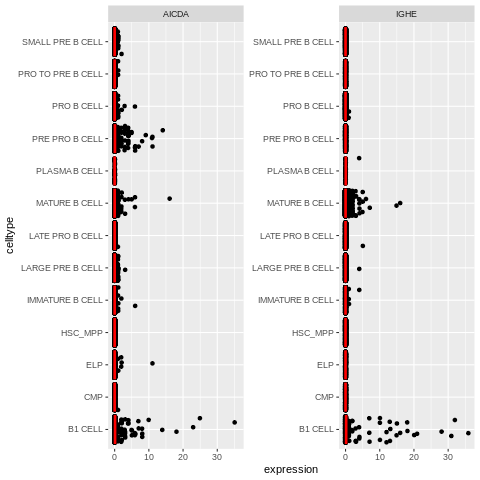

In [263]:
%%R
tmp <- data.frame(gene = rep(rownames(sce), times = ncol(sce)),
                  expression = c(counts(sce)[rownames(sce), ]),
                  celltype = rep(sce$anno_lvl_2, each = 2))

ggplot(tmp, aes(x = celltype, y = expression)) +
  geom_jitter(height = 0.1) +
  stat_summary(geom = "crossbar", fun = "mean", color = "red") +
    coord_flip() +
  facet_wrap(~ gene, scales = "free_y") 

In [ ]:
sc.pl.umap(adata_nkt, color='anno_lvl_2', legend_loc="on data")

## Aggregate gene expression profiles by sample and celltypes

To use MEFISTO/MOFA

In [172]:
def _test_pseudobulk(adata):
    pbulk_adata = anndata2pseudobulk(adata, ["Sample", "anno_lvl_2", "organ","donor", "method"])
    adata.obs["pseudobulk_sample"] = adata.obs[group_by].agg("-".join, axis=1)
    keep_cells = (adata.obs.organ=="TH") & (adata.obs.anno_lvl_2=="MATURE B CELL")
    keep_samples = (pbulk_adata.obs.organ=="TH") & (pbulk_adata.obs.anno_lvl_2=="MATURE B CELL")
    if all(adata.obs[keep_cells]["pseudobulk_sample"].isin(pbulk_adata.obs_names[keep_samples])):
        return(None)
    else:
        print("ERROR! Pseudobulking went wrong")
        
def anndata2pseudobulk(adata, group_by, agg="s"):
    '''
    Params:
    ------
    adata: the anndata object
    group_by: list of obs columns to use for aggregation
    agg: "s" for sum (if adata.X are counts), "m" for mean (if adata.X are log-counts)
    '''
    if agg=="a" and "log1p" in adata.uns_keys():
        print("adata.X is in log-transformed, pseudobulking should be done on counts")
        return()
    ## Make obs for pseudobulk
    pseudobulk_obs = adata.obs[group_by].drop_duplicates()
    pseudobulk_obs.index = pseudobulk_obs[group_by].agg("-".join, axis=1)
    ## Add column to obs assigning cells to pseudobulk samples
    adata.obs["pseudobulk_sample"] = adata.obs[group_by].agg("-".join, axis=1)
    ## Sum counts from same sample
    sample_dummies = pd.get_dummies(adata.obs["pseudobulk_sample"])[pseudobulk_obs.index].values
    sample_dummies = scipy.sparse.csr_matrix(sample_dummies)
    pseudobulk_X = adata.X.T.dot(sample_dummies)
    if agg=="m":
        pseudobulk_X = pseudobulk_X/sample_dummies.sum(0)
    ## Make new anndata object
    pseudobulk_adata = anndata.AnnData(pseudobulk_X.T, obs=pseudobulk_obs, var=adata.var)
    ## Add number of cells to obs 
    n_cells = adata.obs.groupby('pseudobulk_sample').count().iloc[:,0]
    n_cells.name = "n_cells"
    pseudobulk_adata.obs = pd.concat([pseudobulk_adata.obs, n_cells], axis=1)
    return(pseudobulk_adata)

In [173]:
_test_pseudobulk(adata)

In [174]:
pseudobulk_adata_b = anndata2pseudobulk(adata_b_raw, ["Sample", "anno_lvl_2", "organ","donor", "method"])

In [176]:
# pseudobulk_adata.write_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.NKT_CLEAN.pseudobulk.h5ad")
pseudobulk_adata_b.write_h5ad("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_raw_count.wGut.B_CLEAN_CLEAN.pseudobulk.h5ad")

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


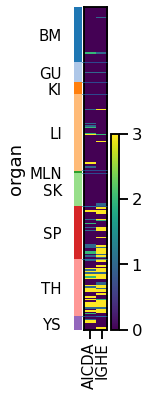

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'pseudobulk_sample' as categorical


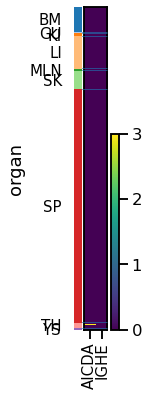

In [177]:
plt.rcParams["figure.figsize"] = [10,10]
sc.pl.heatmap(pseudobulk_adata_b[pseudobulk_adata_b.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])], ["AICDA","IGHE"], groupby='organ', vmax=3)
sc.pl.heatmap(adata_b_raw[adata_b_raw.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])], ["AICDA","IGHE"], groupby='organ', vmax=3)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  Fu

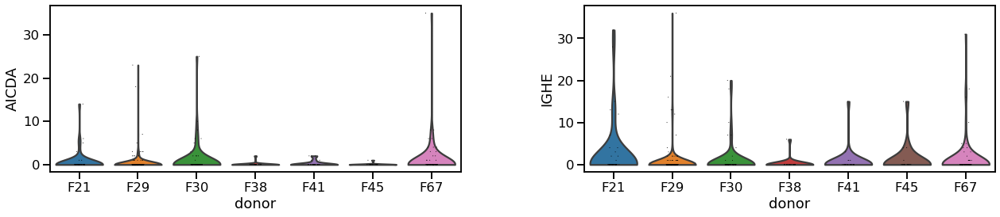

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  Fu

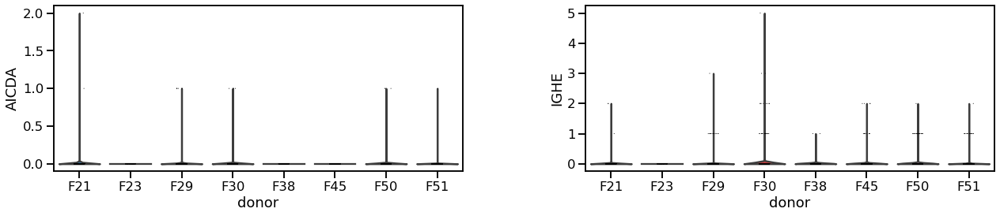

In [102]:
sc.pl.violin(adata_b_raw[(adata_b_raw.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])) & (adata_b_raw.obs.organ.isin(["TH"]))], ["AICDA","IGHE"], groupby='donor', vmax=3)
sc.pl.violin(adata_b_raw[(adata_b_raw.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])) & (adata_b_raw.obs.organ.isin(["SP"]))], ["AICDA","IGHE"], groupby='donor', vmax=3)

In [178]:
org = pseudobulk_adata_b[pseudobulk_adata_b.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])].obs["organ"]
x = pseudobulk_adata_b[pseudobulk_adata_b.obs.anno_lvl_2.isin(["B1 CELL", "MATURE B CELL"])][:, ["AICDA", "IGHE"]].X.toarray()
df = pd.DataFrame(x, columns=["AICDA", "IGHE"])
df['organ'] = org.values

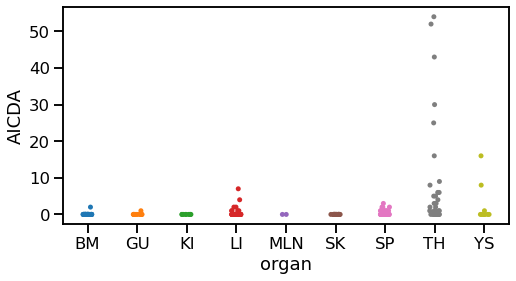

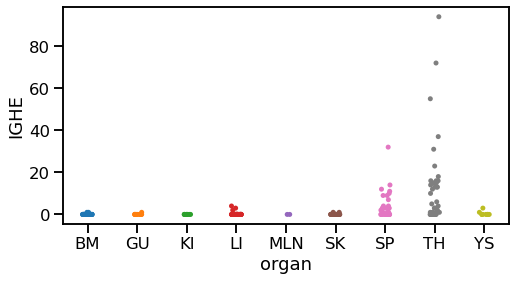

In [179]:
plt.rcParams["figure.figsize"] = [8,4]
sns.set_context("talk")
sns.stripplot(data=df, x="organ", y="AICDA", size=5);
plt.show()
sns.stripplot(data=df, x="organ", y="IGHE");

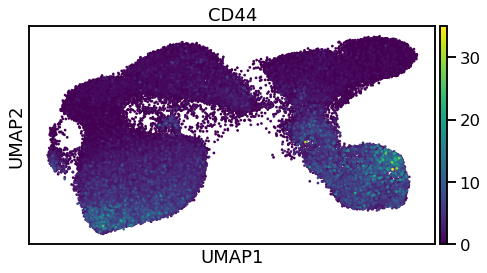

In [98]:
sc.pl.umap(adata_b_raw, color="CD44", size=30)

Make model matrix

In [159]:
df = pseudobulk_adata.obs[['organ', 'anno_lvl_2']].reset_index().groupby(['organ', 'anno_lvl_2']).count().reset_index()

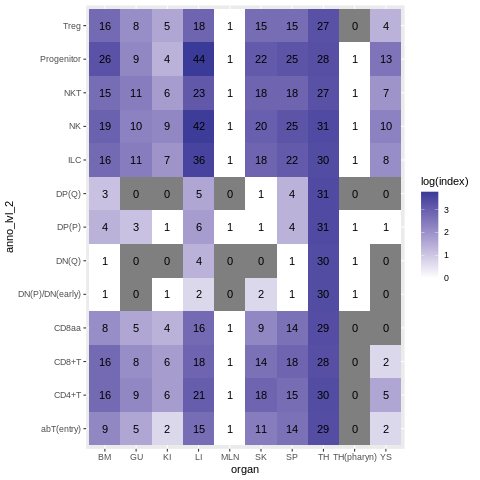

In [160]:
%%R -i df
head(df)
ggplot(df, aes(organ, anno_lvl_2, fill=log(index))) + 
geom_tile() +
geom_text(aes(label=index)) +
scale_fill_gradient2()

In [38]:
%%R -i pseudobulk_adata
pseudobulk_adata

class: SingleCellExperiment 
dim: 33694 1305 
metadata(0):
assays(1): X
rownames(33694): TSPAN6 TNMD ... RP11-107E5.4 RP11-299P2.2
rowData names(2): GeneName GeneID
colnames(1305): F21_LI_45P-NK-LI-F21-3GEX F21_LI_45P-CD4+T-LI-F21-3GEX
  ... F66-FMI-0-SC-1-Treg-GU-F66-3GEX F72-FMI-0-SC-1-DP(P)-GU-F72-5GEX
colData names(7): Sample anno_lvl_2 ... age pseudobulk_sample
reducedDimNames(0):
altExpNames(0):


In [54]:
%%R
m <- convert_formula_to_model_matrix(formula= ~ 1 + donor + method + organ + anno_lvl_2 + (organ*anno_lvl_2), col_data=colData(pseudobulk_adata)) 
## Remove columns that sum to 0 in model matrix (e.g. tissue specific cell types)
is_zero_column <- DelayedMatrixStats::colCounts(m, value = 0) == nrow(m)
model_mat <- m[,which(colSums(m) > 2)]
ncol(m)

[1] 154


In [41]:
%%R
assay(pseudobulk_adata) <- as.matrix(assay(pseudobulk_adata))

In [70]:
hvgs = adata_nkt.var_names


In [71]:
"CD4" in hvgs

True

In [83]:
markers = np.array(["CD4", "CD8A", "SPIB", "NKG7", "CCR9", "PTCRA", "RAG1", "TOX2", 'AREG', 'TLE1', 'IL4I1'])
[x for x in markers if x in hvgs]

['CD4',
 'CD8A',
 'SPIB',
 'NKG7',
 'CCR9',
 'PTCRA',
 'RAG1',
 'TOX2',
 'AREG',
 'TLE1',
 'IL4I1']

In [84]:
%%R -i markers
markers
fit <- glm_gp(pseudobulk_adata[markers,], design = model_mat, on_disk = FALSE)
# fit_cd4 <- glm_gp(adata_sub[c("CD8A"),sample(colnames(adata_sub), 1000)], design = ~ 1 + organ + anno_lvl_2, on_disk = FALSE)
# fit_cd8 <- glm_gp(adata_sub[c("CD8A"),], design = ~ 1 + organ + anno_lvl_2, on_disk = FALSE)
summary(fit)

glmGamPoiFit object:
The data had 11 rows and 1305 columns.
A model with 108 coefficient was fitted.

Beta:
            Min 1st Qu. Median 3rd Qu.   Max
Intercept -3.72  0.3532  2.247   2.824 3.340
 donorF21 -1.87 -0.9469  0.371   0.491 2.996
 donorF22 -0.93 -0.0806  0.185   0.664 0.864
...

deviance:
 Min 1st Qu. Median 3rd Qu.  Max
 545     793    942    1334 1385

overdispersion:
  Min 1st Qu. Median 3rd Qu.  Max
 1.22    1.52   3.08    4.35 6.51

Shrunken quasi-likelihood overdispersion:
  Min 1st Qu. Median 3rd Qu. Max
 0.41   0.497  0.999     1.4 2.1

size_factors:
   Min 1st Qu. Median 3rd Qu. Max
 0.001    0.15  0.891    4.37 912

Mu:
      Min 1st Qu. Median 3rd Qu.    Max
 1.31e-19   0.395   3.48    29.8 477353



In [88]:
%%R -o coefficients 
coefficients <- summary(fit)$Beta
res <- summary(fit)$deviances

rownames(coefficients) <- markers
colnames(coefficients) <- colnames(model_mat)
coefficients <- data.frame(coefficients)

# rownames(res) <- genes
# colnames(res) <- colnames(model_mat)
# res <- data.frame(res)

<AxesSubplot:>

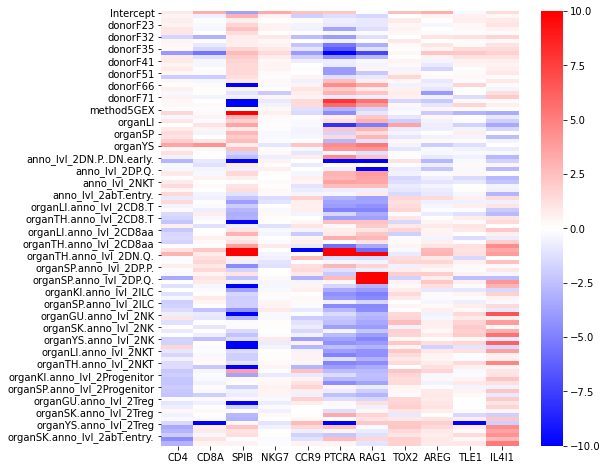

In [89]:
sns.heatmap(coefficients.T, cmap="bwr", vmax=10, vmin=-10)

In [93]:
import re
organ_col_mask = [bool(re.match("^organ..$", x)) for x in coefficients.T.index]
anno_col_mask = [bool(re.match("^anno_lvl_2", x)) for x in coefficients.T.index]
int_col_mask = [bool(re.match("^organ...anno_lvl_2", x)) for x in coefficients.T.index]

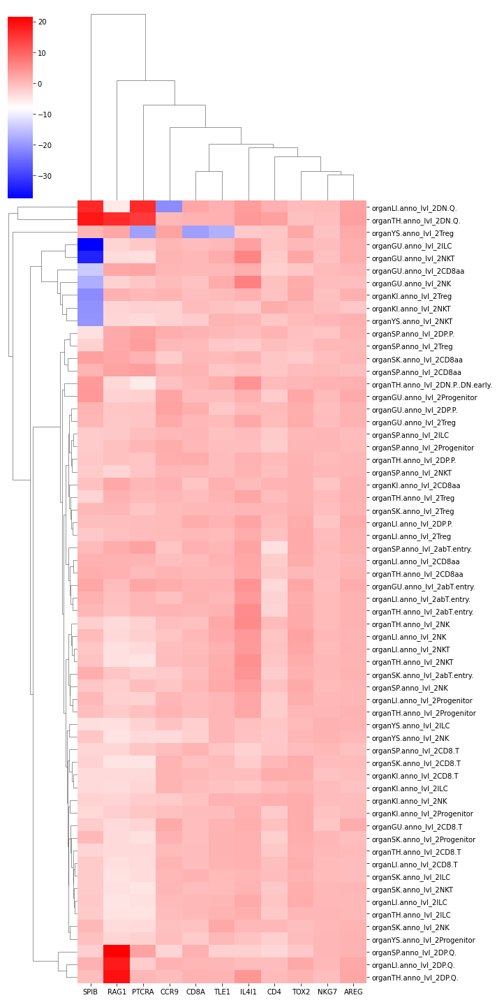

In [103]:
sns.clustermap(coefficients.T[int_col_mask], cmap="bwr", figsize=[10,20])

<AxesSubplot:>

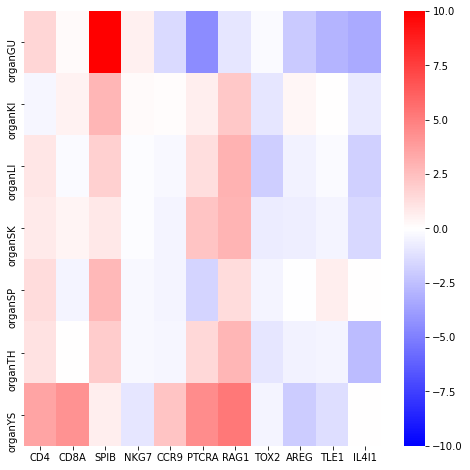

In [92]:
sns.heatmap(coefficients.T[organ_col_mask], cmap="bwr", vmax=10, vmin=-10)
# sns.clustermap(coefficients.T[anno_col_mask], cmap="bwr", vmax=10, vmin=-10)

In [113]:
df = pseudobulk_adata.obs

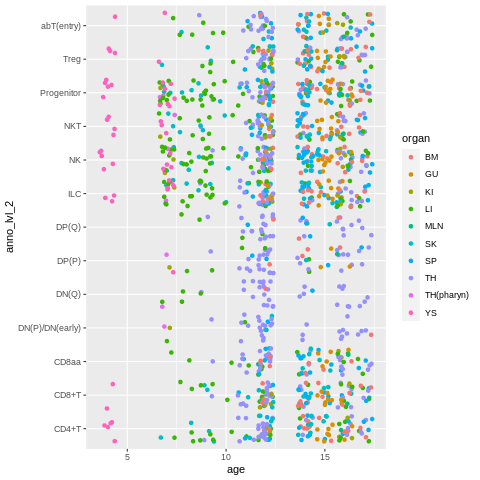

In [117]:
%%R -i df
ggplot(df, aes(age, anno_lvl_2, color=organ)) + 
geom_jitter()

----

### Model by JP

In [20]:
class linear_regression():
    
    def __init__(self,adata):
        self.adata = adata
        self.df = adata.obs
        self.X_exp = adata.X
        self.LR_dict = {}
    
    def celltype_organ(self, anno_key, celltype, others=['organ','method']):
        from sklearn.linear_model import Ridge
        
        self.df['is_%s'%celltype] = [str(x) for x in self.df[anno_key]==celltype] # cell type term
        self.df['%s_organ'%celltype] = [x+'_'+y for x,y in zip(self.df['is_%s'%celltype],self.df['organ'])] # interaction term
        cat = self.df[['is_%s'%celltype, '%s_organ'%celltype] + others] # add organ term and others
        LR = Ridge()
        dummy = pd.get_dummies(cat, drop_first=False)
        LR.fit(dummy, self.X_exp)
        params = list(dummy.columns)
        ct_dict = {'LR': LR, 'params': params}
        self.LR_dict[celltype] = ct_dict
        
    def celltype_organ_2(self, anno_key, celltype, others=['method']):
        from sklearn.linear_model import Ridge
        
        self.df['is_%s'%celltype] = [str(x) for x in self.df[anno_key]==celltype] # cell type term
        self.df['%s_organ'%celltype] = [x+'_'+y for x,y in zip(self.df['is_%s'%celltype],self.df['organ'])] # interaction term
        cat = self.df[['%s_organ'%celltype] + others] # add organ term and others
        LR = Ridge()
        dummy = pd.get_dummies(cat, drop_first=False)
        LR.fit(dummy, self.X_exp)
        params = list(dummy.columns)
        ct_dict = {'LR': LR, 'params': params}
        self.LR_dict[celltype] = ct_dict
    
    def show_param_genes(self, celltype, param, toshow=20, output=False):
        coef = self.LR_dict[celltype]['LR'].coef_[:,self.LR_dict[celltype]['params'].index(param)]
        order = np.argsort(-coef)
        names = adata.var_names[order][:toshow]
        values = coef[order][:toshow]
        print(['%s:%.2f'%(x,y) for x,y in zip(names,values)])
        if output:
            return names, values
    
    def violin_plot(self, celltype, gene):
        LR = self.LR_dict[celltype]['LR']
        params = self.LR_dict[celltype]['params']
        
        Exp = self.adata.raw.X
        exp = Exp[:,self.adata.raw.var_names==gene].todense().A1

        self.df[gene+'_exp'] = exp

        fig = plt.figure(figsize=(8,2))
        ax = plt.subplot(111)
        sns.violinplot(x='is_%s'%(celltype),y=gene+'_exp',
                       hue='organ',data = self.df,
                       scale='width',linewidth=0,inner=None,rasterized=True,cut=0,ax=ax)
        plt.xticks(rotation=0)
        plt.grid(False)
        plt.xlabel('')
        ax.legend(bbox_to_anchor=(1.2, 1.05))
        plt.show()

        gidx = self.adata.var_names==gene

        cf = LR.coef_[gidx][0]
        cf_idx = np.argsort(-cf)
        print('\n'.join(['%.2f : %s'%(a,b) for a,b in zip(cf[cf_idx],np.array(params)[cf_idx])]))


In [ ]:
linear_regression(adata)